## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

*  (1) Camera Calibration
The below function will calibrate the camera -> to do is include a a dump of the calibration to a pickle file and ensure we save individual "undistorted" images for the project sumbission


## Camera Calibration (criteria 1)

*  OpenCV functions or other methods were used to calculate the correct camera matrix and distortion coefficients using the calibration chessboard images provided in the repository (note these are 9x6 chessboard images, unlike the 8x6 images used in the lesson).

* The distortion matrix should be used to un-distort one of the calibration images provided as a demonstration that the calibration is correct. 

* Example of undistorted calibration image is Included in the writeup (or saved to a folder).

# Additional Comments:
###  Camera Calibration - defining error and or minimum cal images.

   An additional step was implemnted for verificaiton of the output.
   Additional to transform the undistorted images and compare the positioning / determine error characteristics of the functions.
   
   Observation:  Variation in the cornerPixels / chessboard corners when trasnformed indicating a pixel error in the functions.
   
   
   Positioning of the images at this stage should be as close as possible (pixel error approaching 0)
   Error likely due to lens error of the camera used.  It may be worth to characterise the error in real space to understand the impact, especially when transforming the image -> may be particularly handy for having an error weighting on particular regions of the image.
   
   *  suggestion to calibrate using a "calibrated chessboard" at calibrated distances to the camera.
   *  It would be good to understand what the image error is with respect to objects in the real world especially when we are tranforming objects / lines.
   
   * One topic or hint for the project was to ensure that the line curvature values make sense.
   * if we had "calibration points" from the images (maybe GPS data) at certain lane positions, and camera/location data we      could understand what the error is in the curvature calculations? This may actually be completely insignificant though if our lane detection / tracking is robust.  However it may be useful when travelling at faster speeds. 
   
   
   The positiong of the images should be as close as possible, (pixel error -> 0 or +-1)
   
   Another calibration step would be to use a calibrated images with mm or um on there.
   (Of course this depends on the    printer accuracy also..)
   
   
*  Good idea to calculate the error value of the calibration.  
*  When transforming the images, to and comparing them it was found that the pixel positioning varied.
*  It will be important to know what the impact of this error is in our actual application. 
   The pixel error may have a greater impact when we transform lines closer to the the horizon (infinite point) 
   as we transform to real space.


Populating the interactive namespace from numpy and matplotlib


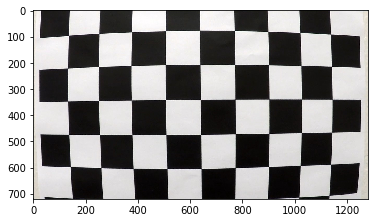

In [76]:
%pylab inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
img=mpimg.imread('camera_cal/calibration1.jpg')
imgplot = plt.imshow(img)
plt.show()


In [77]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import os
import pickle
import matplotlib.image as mpimg
#%matplotlib qt
#%pylab inline

def camera_calibration(calibrationImg, nx=9, ny=6 ):
    """"
    computes camera calibration matrix and distortion coeffients given a set of chessboard images
        Args:        @nx the number of inside corners in x of the calibration chessboard image
                     @ny the number of inside corners in y of the calibration chessboard image
                     @ Default chessboard size is nx = 9, ny = 6)
                     @ calibrationImages a list of calibration images. 
        Returns:  @undistortedImg - undistorted images of the original calibrationImages 
    """
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.
    objp = np.zeros((ny*nx,3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)
    
    for fname in images:
        # Step through the list and search for chessboard corners
        #copy of image
        img = mpimg.imread(fname)
        imgSize = (img.shape [1], img.shape[0])
        
        #note using glob so must convert to grayscale as it is read as a BGR image
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

        #print(corners.shape)
        # If corners are found, add object points and image points  
        if ret == True:
            print("true " + fname +'\r\n')
            objpoints.append(objp)
            imgpoints.append(corners)  
            # Draw and display the corners
            img = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
            ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints,imgSize, None, None) 
            # save the calibration mtx and distortion coefficients to file.
            # create pickle file in camera cal image directory
            #cameraCalPickle = open('./pickled_data/camera_calibration.p', 'wb')
            pickle.dump( { 'mtx': mtx, 'dist': dist }, open('camera_cal/pickled_data/camera_calibration.p', 'wb'))  
            #undistort the image 
            undistort = cv2.undistort(img, mtx, dist, None, mtx) 
            undistortedImg = undistort            
    return 


In [78]:
images = glob.glob('camera_cal/calibration*.jpg')
print(os.getcwd())
pickle.dump( { 'mtx': mtx, 'dist': dist }, open('camera_cal/pickled_data/camera_calibration.p', 'wb'))


C:\Users\louiz\Udacity\Project_2_Advanced_Lane_Finding\CarND-Advanced-Lane-Lines-master


In [79]:
test = camera_calibration(images)

true camera_cal\calibration10.jpg

true camera_cal\calibration11.jpg

true camera_cal\calibration12.jpg

true camera_cal\calibration13.jpg

true camera_cal\calibration14.jpg

true camera_cal\calibration15.jpg

true camera_cal\calibration16.jpg

true camera_cal\calibration17.jpg

true camera_cal\calibration18.jpg

true camera_cal\calibration19.jpg

true camera_cal\calibration2.jpg

true camera_cal\calibration20.jpg

true camera_cal\calibration3.jpg

true camera_cal\calibration6.jpg

true camera_cal\calibration7.jpg

true camera_cal\calibration8.jpg

true camera_cal\calibration9.jpg



failed camera_cal\calibration1.jpg

true camera_cal\calibration10.jpg

true camera_cal\calibration11.jpg

true camera_cal\calibration12.jpg

true camera_cal\calibration13.jpg

true camera_cal\calibration14.jpg

true camera_cal\calibration15.jpg

true camera_cal\calibration16.jpg

true camera_cal\calibration17.jpg

true camera_cal\calibration18.jpg

true camera_cal\calibration19.jpg

true camera_cal\calibration2.jpg

true camera_cal\calibration20.jpg

true camera_cal\calibration3.jpg

failed camera_cal\calibration4.jpg

failed camera_cal\calibration5.jpg

true camera_cal\calibration6.jpg

true camera_cal\calibration7.jpg

true camera_cal\calibration8.jpg

true camera_cal\calibration9.jpg



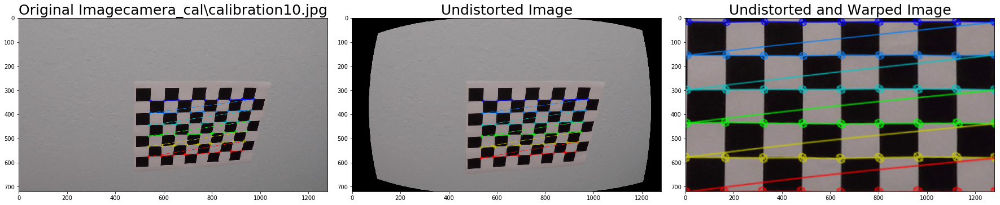

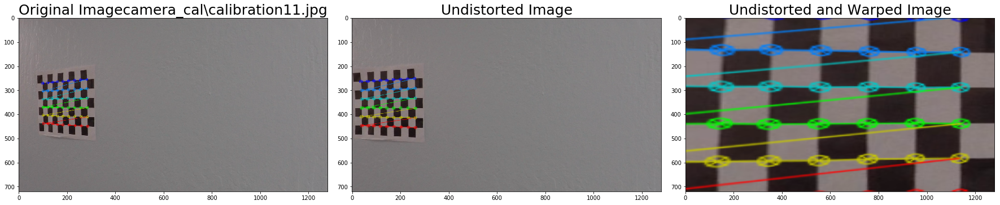

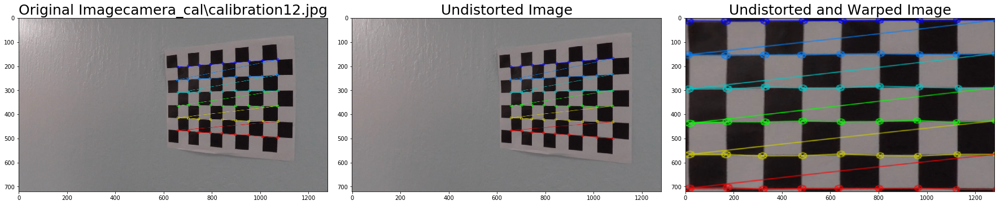

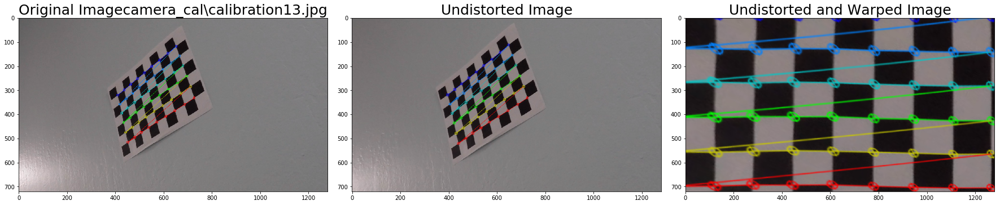

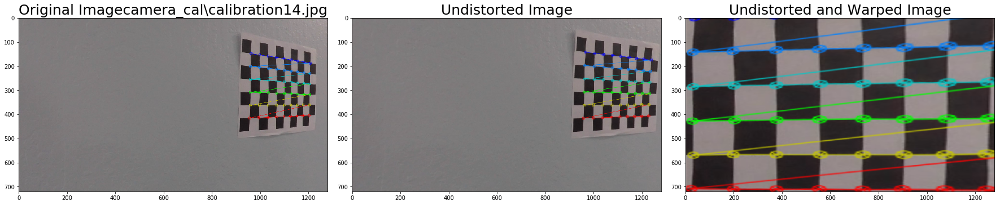

...

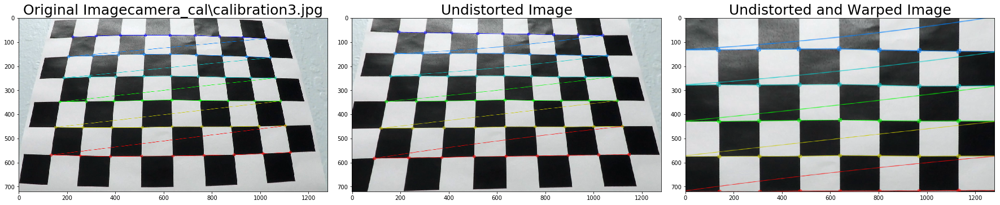

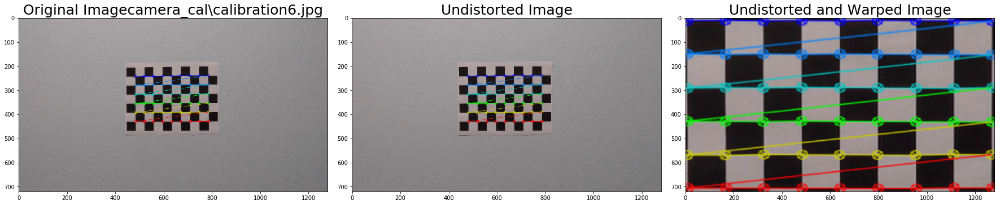

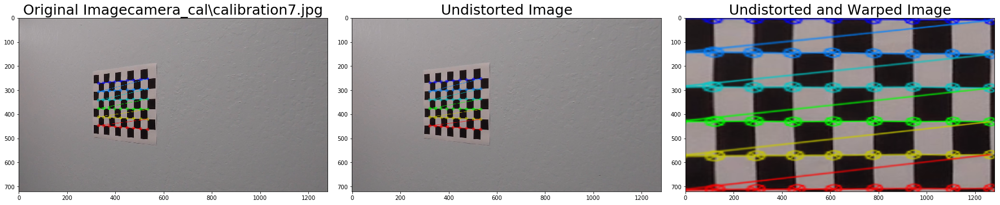

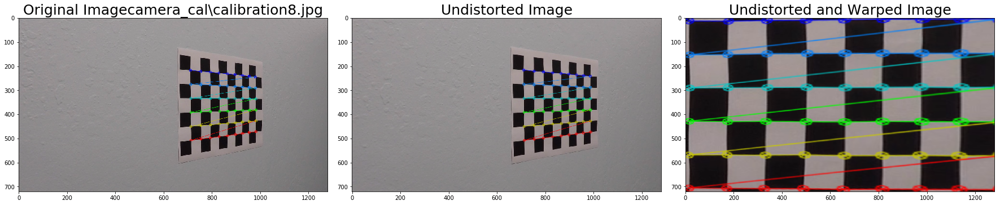

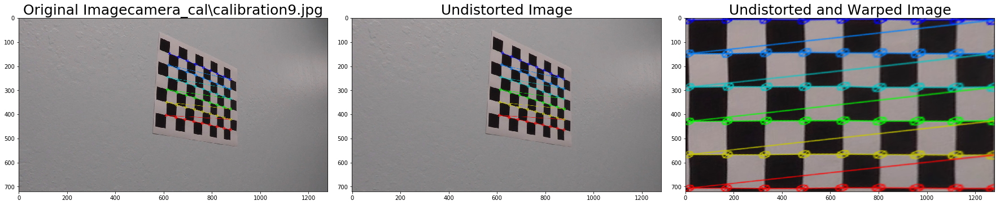

In [80]:

import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import os
import pickle
import matplotlib.image as mpimg
#%matplotlib qt
#%pylab inline

objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

nx = 9  # number of inside corners in x
ny = 6  # number of inside corners in y

objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    #copy of image
    orignalImg = cv2.imread(fname, cv2.IMREAD_COLOR)
    #img = mpimg.imread(fname)
    #note using glob so must convert to grayscale as it is read as a BGR image
    gray = cv2.cvtColor(orignalImg, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)
    
    #print(corners.shape)
    # If corners are found, add object points and image points
    if ret == True:
        print("true " + fname +'\r\n')
        objpoints.append(objp)
        
        # more accurate corners
        #corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        #imgpoints.append(corners2)
        imgpoints.append(corners)  # note if you decide to just use fr
        
        # Draw and display the corners
        imgWithCorners = cv2.drawChessboardCorners(orignalImg, (nx,ny), corners, ret)
        # double check colour or gray image => here we are using a gray image.  For colour images img.shape[1::-1] or img.shape[1:]
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None) 
     
        undistortImg = cv2.undistort(orignalImg, mtx, dist, None, mtx) 

        src = np.float32([corners[0],
                           corners[nx - 1], 
                           corners[ny*nx - nx], 
                           corners[ny*nx -1]])         
        
        h,w = orignalImg.shape[:2]
        
        offset = 15
        dst = np.float32([[offset,offset],[w-offset,offset],[offset,h-offset],[w-offset,h-offset]])
        # d) use cv2.getPerspectiveTransform() to get M, the transform matrix
        M = cv2.getPerspectiveTransform(src, dst)
        
        # e) use cv2.warpPerspective() to warp your image to a top-down view
        warped = cv2.warpPerspective(undistortImg, M, (w,h), flags=cv2.INTER_LINEAR)
        
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(orignalImg)
        ax1.set_title('Original Image' + fname, fontsize=25)
        ax2.imshow(undistortImg)
        ax2.set_title('Undistorted Image', fontsize=25)
        ax3.imshow(warped)
        ax3.set_title('Undistorted and Warped Image', fontsize=25)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

        cv2.waitKey(500)
        
        #debug line to show which images are OK for calibration
    if ret == False:
        print("failed " + fname +'\r\n')
        
pickle.dump( { 'mtx': mtx, 'dist': dist }, open('camera_cal/pickled_data/camera_calibration.p', 'wb'))        
#cv2.destroyAllWindows()

In [81]:
#print(fname)

In [82]:
print(img.shape[:2], )
print(os.getcwd())
#img = cv2.imread('../camera_cal/calibration1.jpg')
#height, width = img.shape[:2]

(720, 1280)
C:\Users\louiz\Udacity\Project_2_Advanced_Lane_Finding\CarND-Advanced-Lane-Lines-master


#  The Goal of this Project
In this project, your goal is to write a software pipeline to identify the lane boundaries in a video from a front-facing camera on a car. The camera calibration images, test road images, and project videos are available in the project repository or in the repository folder included with the workspace.

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
###   * Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


In [83]:
import numpy as np
import cv2
import glob
import os
import pickle
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

#%matplotlib qt
#%pylab inline

def thresholdHLS(image, s_thresh=(130, 255), sx_thresh=(40, 100) ):   
    #important to make a copy of the original image
    img = np.copy(image)
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    
    # define the HLS channels
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
       
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    return combined_binary     


def undistort(image, mtx, dist):
    """"
    computes camera calibration matrix and distortion coeffients given a set of chessboard images
        Args:        @ image is the input image
                     @ mtx calibration matrix coeeficient ny the number of inside corners in y of the calibration chessboard image
                     @ dist calibration distortion coefficient . 
    Returns:  @undistortedImg - undistorted images of the input image
    """
    undistortedImg = cv2.undistort(image, mtx, dist, None, mtx)
    return undistortedImg
   

def showImages(images, cols = 2, rows = 5, figsize=(15,10)):
    """
    Display `images` on a [`cols`, `rows`] subplot grid.
    """
    imgLength = len(images)
    fig, axes = plt.subplots(rows, cols, figsize=figsize)
    indexes = range(cols * rows)
    for ax, index in zip(axes.flat, indexes):
        if index < imgLength:
            imagePathName, image = images[index]
            ax.imshow(image)
            ax.set_title(imagePathName)            
#showImages(list(map(lambda img: (img[0], cv2.cvtColor(img[1], cv2.COLOR_BGR2RGB)),roadmages)), 2, 3, (15, 14))   

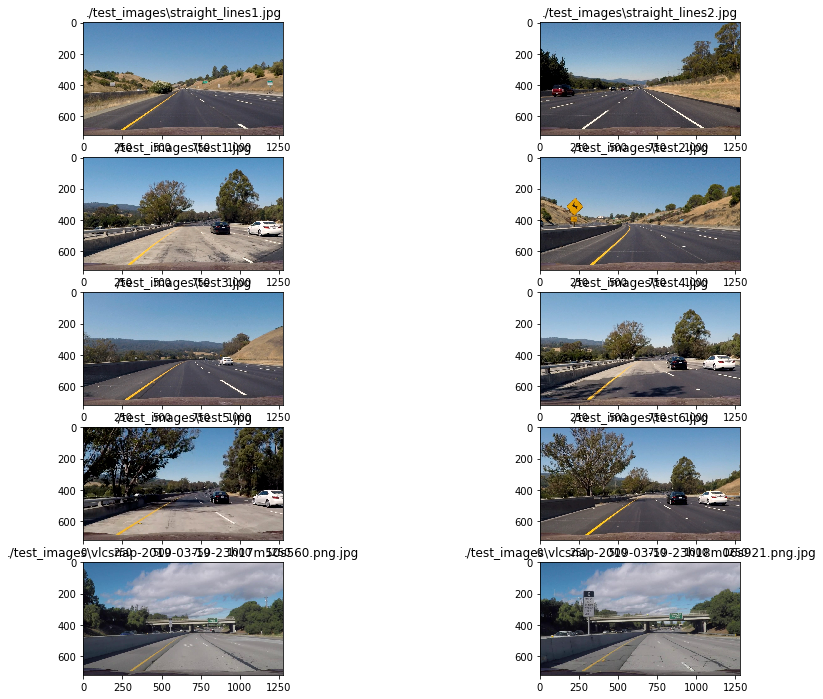

In [84]:
roadImages = list(map(lambda fileName: (fileName, cv2.imread(fileName)), glob.glob('./test_images/*.jpg')))               
showImages(list(map(lambda img: (img[0], cv2.cvtColor(img[1], cv2.COLOR_BGR2RGB)),roadImages)), 2, 5, (15, 12))

In [85]:
# undistort the images

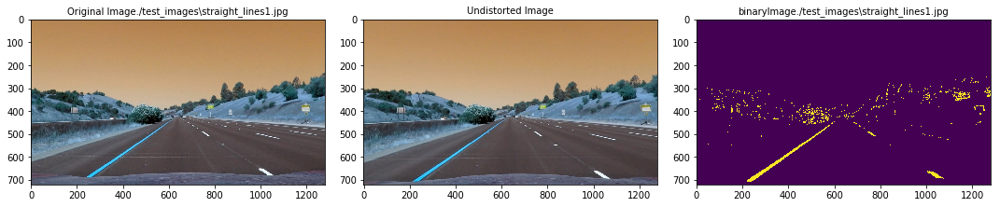

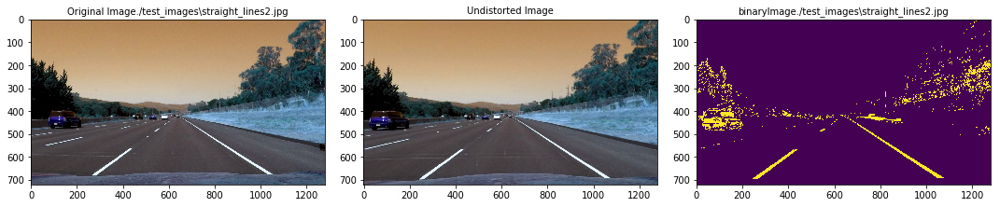

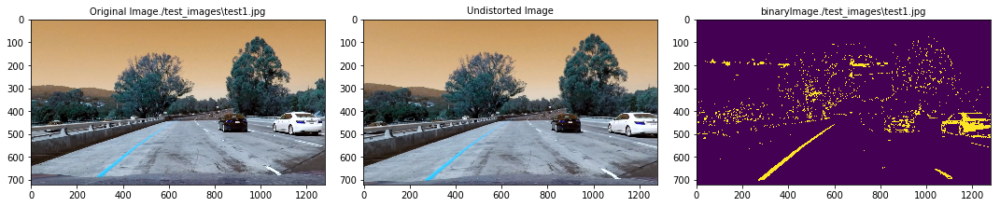

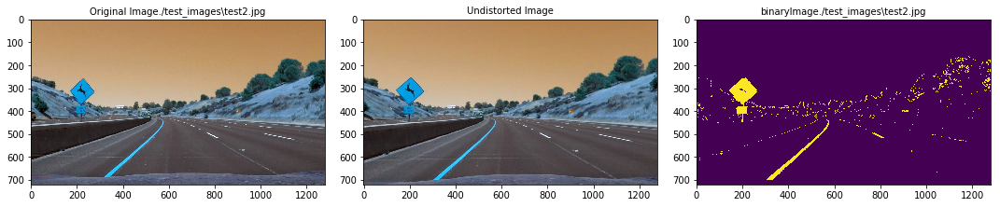

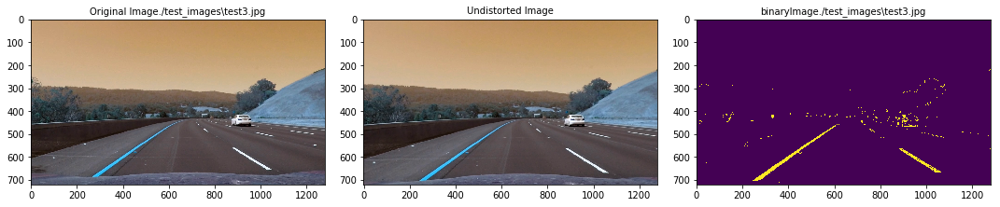

...

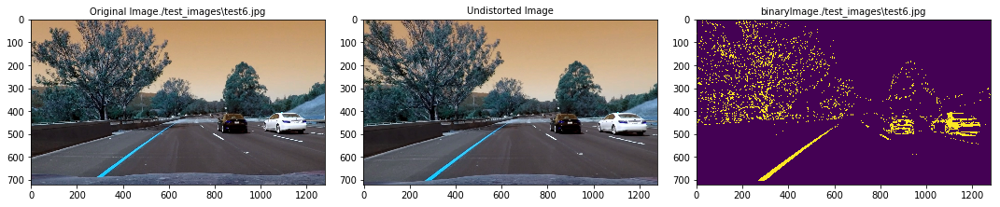

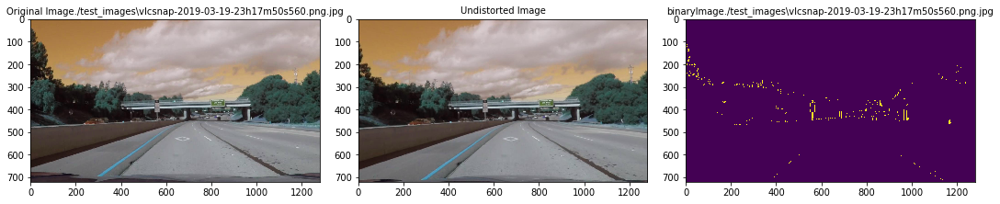

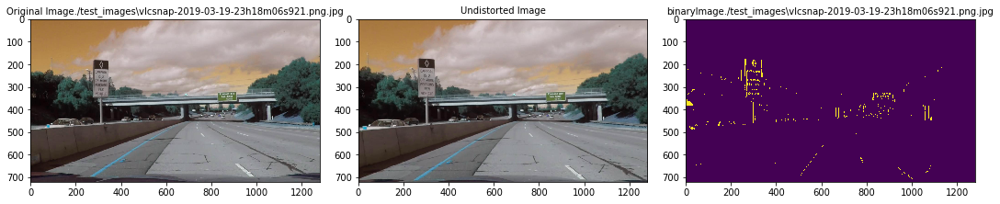

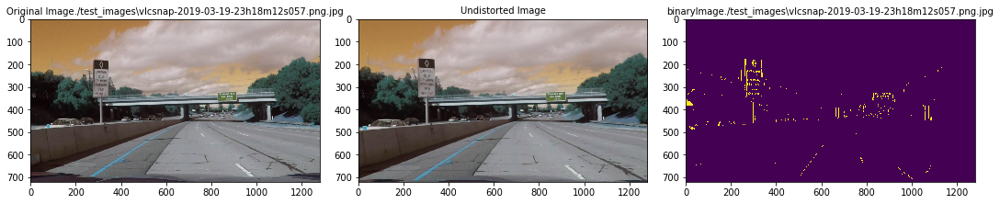

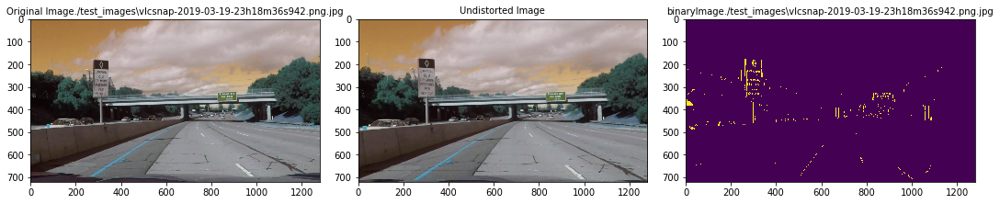

In [86]:
%matplotlib inline

testImages = roadImages[2][1] 
roadImagesNames = glob.glob('./test_images/*.jpg')
undistortedRoadImages = []
for fname in roadImagesNames: 
    orignalImg = cv2.imread(fname, cv2.IMREAD_COLOR)
    undistortedRoad = cv2.undistort(orignalImg, mtx, dist, None, mtx)
    binaryImage = thresholdHLS(undistortedRoad, s_thresh=(135, 255), sx_thresh=(50, 255))
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 10))
    f.tight_layout()
    ax1.imshow(orignalImg)
    ax1.set_title('Original Image' + fname, fontsize=10)
    ax2.imshow(undistortedRoad)
    ax2.set_title('Undistorted Image', fontsize=10)   
    ax3.imshow(binaryImage)
    ax3.set_title('binaryImage' + fname, fontsize=10)
    
    #undistortedRoadImages.append(undistortedRoad) 


In [87]:
#showImages(list(map(lambda img: (img[0], cv2.cvtColor(img[1], cv2.COLOR_BGR2RGB)),undistortedRoadImages)), 2, 3, (15, 14))

#  The Goal of this Project
In this project, your goal is to write a software pipeline to identify the lane boundaries in a video from a front-facing camera on a car. The camera calibration images, test road images, and project videos are available in the project repository or in the repository folder included with the workspace.

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
##  * Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


#### Some application assesment notes:
use case (1) complex 4 lanes 
     - inner most left lane /  most right lane
     - outer  most left lane /  most right lane
    expectation is that  the lane markings will not be in even in the image, skewed either left or right most in the image.
    the horizon will remain the same.
    the vanishing point of the road will be skewed.
    
for a more complex alogirth mark "auxilary driving lanes"
consider where the line markings will be projected for a sweet point.  Avoid obscuring/masking out features by apex that is centred in the image.

From the test images above / undistorted
200 +- margin
1200 +- margi

horizon @ 350 + 50 margin (neglect - 50 for now)
might be a good idea to characterise key /stats with a larger sample size.

A good idea would be to define variables for the width height dimensions so that the calculation can work on variable image sizes.  A simple suggestion would be a weighted percentile. 



In [88]:
# draw grid lines on image
step_x = 128
step_y = 90

grid_array_x = np.arange(0, 1280 + 1, step_x)
grid_array_y = np.arange(0, 720 + 1, step_y)
# print(grid_array_x)
# print(grid_array_y)
# print(type(grid_array_x))


def grid_image(image, step_x = 200, step_y = 90):
    """
    computes camera calibration matrix and distortion coeffients given a set of chessboard images
        Args:        @ step_x: width step size
                     @ step_y: height step size 
                     @ input image the grids will be drawn on. 
    Returns:  @grid_image - original image with grid line markings.     
    """   
    height = image.shape[0]
    width = image.shape[1]
    grid_array_x = np.arange(0, width + 1, step_x)
    grid_array_y = np.arange(0, height + 1, step_y)    
    # now draw the lines
    #print("grid_array_x", grid_array_x)
    #print("grid_array_y", grid_array_y)
    grid_image = image
    for i in grid_array_x:
        x1 = i
        y1 = 0
        x2 = i
        y2 = height
        #print("point "+"i" + "(0," + str(i) + ")" + "\n""point 2" +"(" + str(height) + "," + str(i) + ")")
        #print("(" + str(x1) + " "+ str(y1) + ")" + " " + "(" + str(x2) + " "+ str(y2) + ")")
        grid_image = cv2.line(grid_image, (x1, y1), (x2, y2), (255, 0, 0), 5)
        
    for i in grid_array_y:
        x1 = 0
        y1 = i
        x2 = width
        y2 = i
        grid_image = cv2.line(grid_image, (x1, y1), (x2, y2), (255, 0, 0), 5)         
    return grid_image      
    



In [89]:
## todo: really need to pipe in the distorted images into a list.


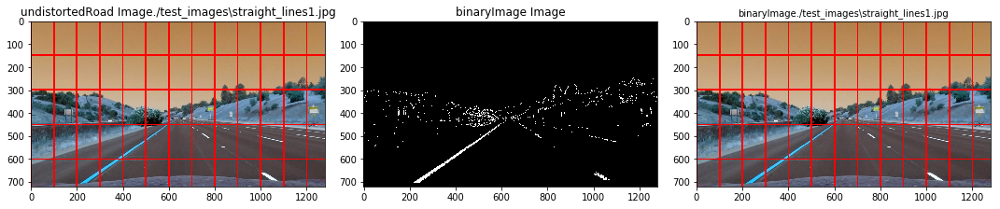

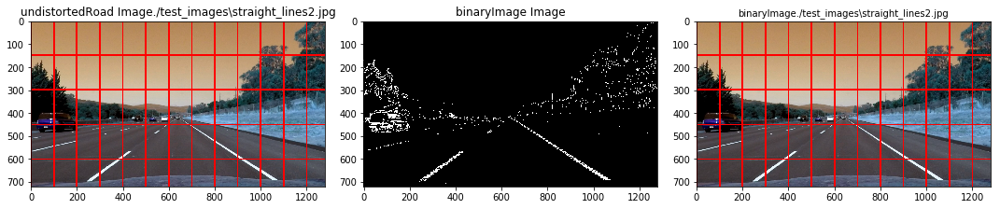

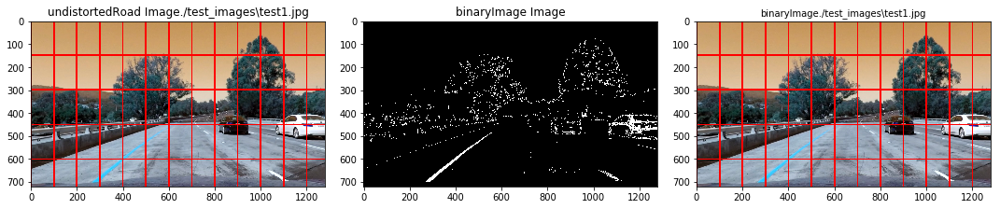

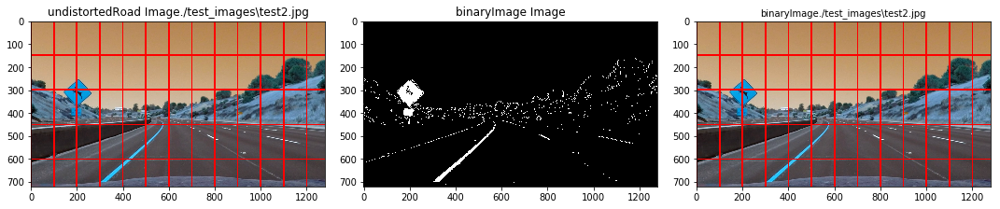

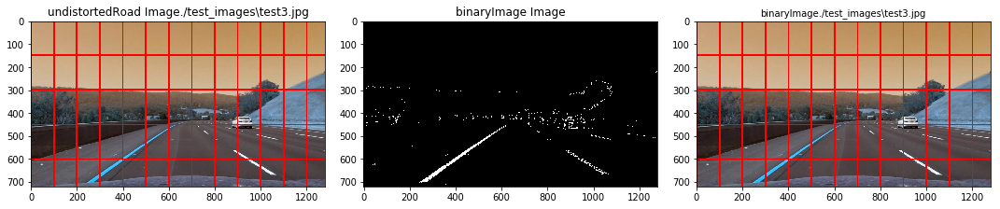

...

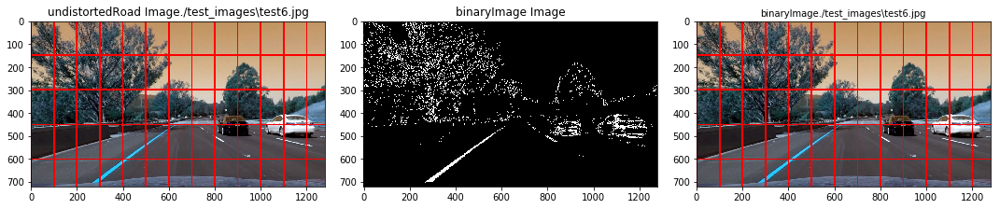

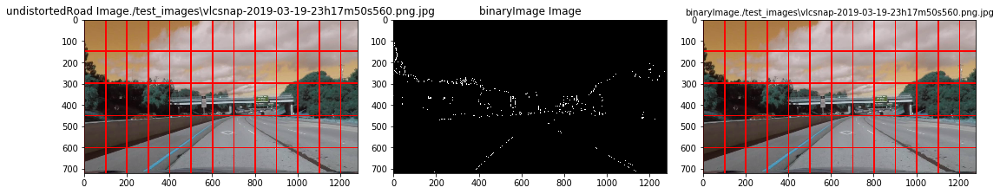

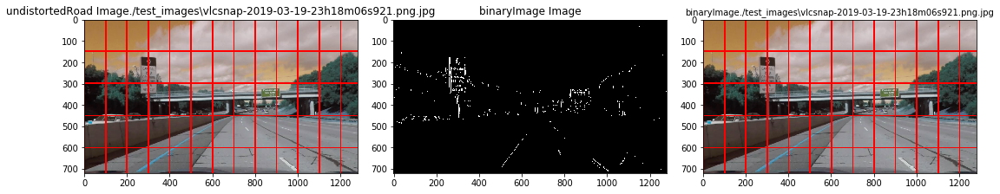

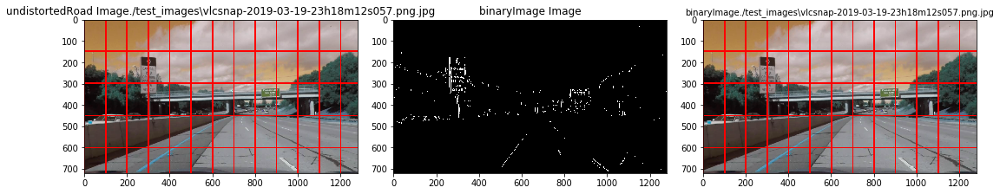

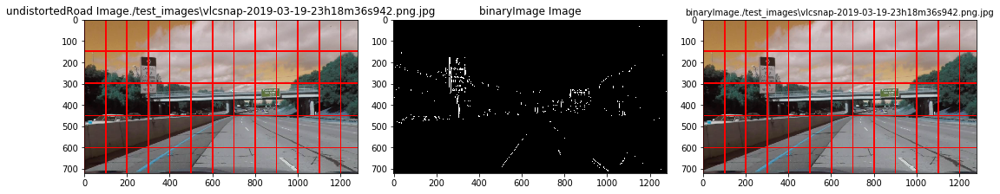

In [90]:
# map with gridsroadImagesNames = glob.glob('./test_images/*.jpg')
for fname in roadImagesNames: 
    orignalImg = cv2.imread(fname)
    undistortedRoad = cv2.undistort(orignalImg, mtx, dist, None, mtx)
    binaryImage = thresholdHLS(undistortedRoad, s_thresh=(200, 255), sx_thresh=(40, 100))
    gridImage = grid_image(undistortedRoad, 100, 150)
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 10))
    f.tight_layout()
    ax1.imshow(undistortedRoad, cmap='gray')
    ax1.set_title('undistortedRoad Image' + fname, fontsize=12)
    ax2.imshow(binaryImage, cmap='gray')
    ax2.set_title('binaryImage Image', fontsize=12)   
    ax3.imshow(gridImage, cmap='gray')
    ax3.set_title('binaryImage' + fname, fontsize=10)



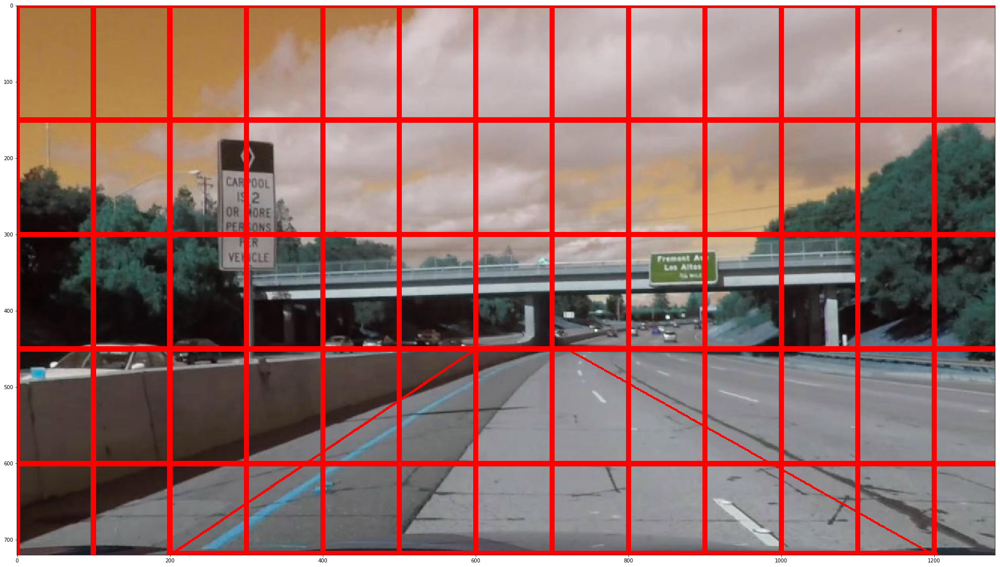

In [91]:
## mark up one sample image with the lines
tempImage = undistortedRoad.copy()

# 8 vertices to draw a polygon
left_lane_start = (200,720)
left_lane_end = (600,450)
right_lane_end  = (1200, 720)
right_lane_start = (720, 450)
tempImage = cv2.line(tempImage, left_lane_start, left_lane_end,(255,0,0), 2)
tempImage = cv2.line(tempImage, left_lane_end, right_lane_start,(255,0,0), 2)
tempImage = cv2.line(tempImage, right_lane_start, right_lane_end,(255,0,0), 2)
tempImage = cv2.line(tempImage, left_lane_start, right_lane_end,(255,0,0), 10)

fig, ax = plt.subplots(figsize=(40, 20))
ax.imshow(tempImage)

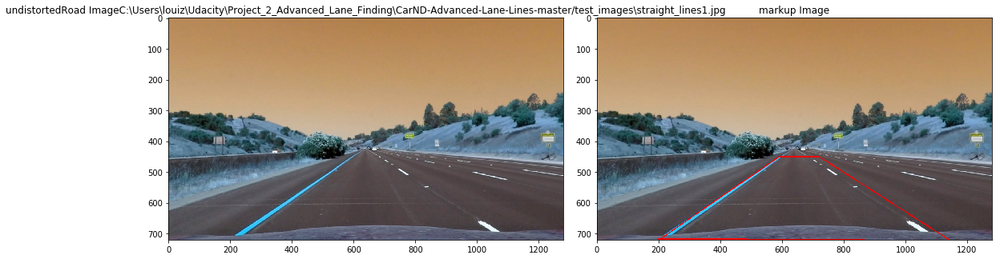

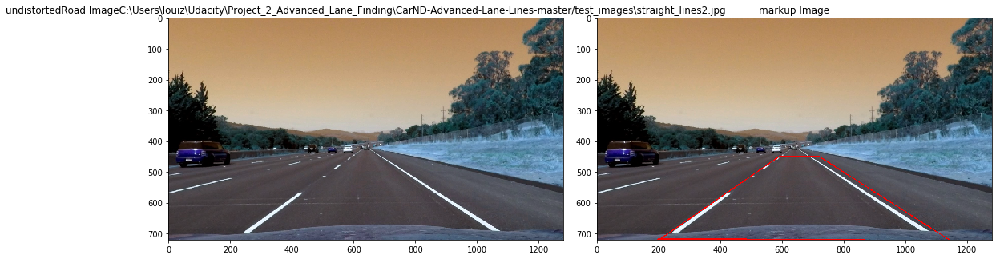

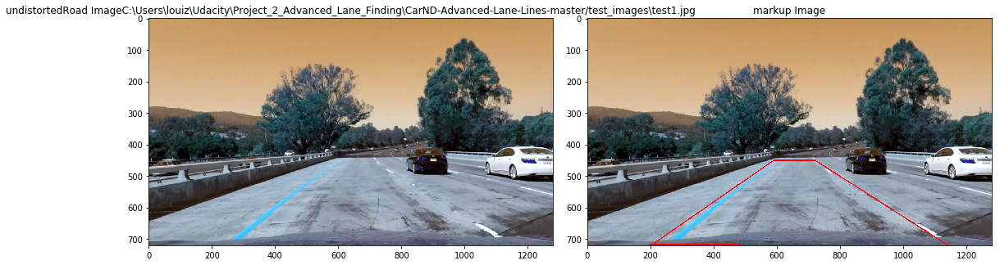

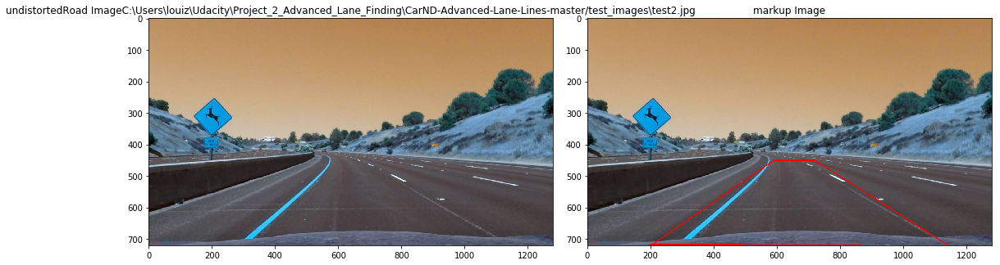

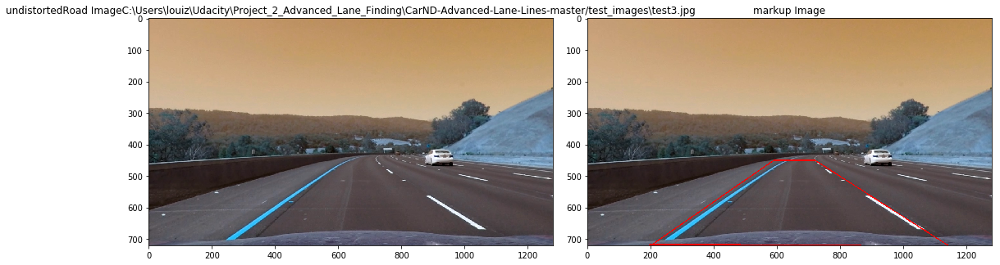

...

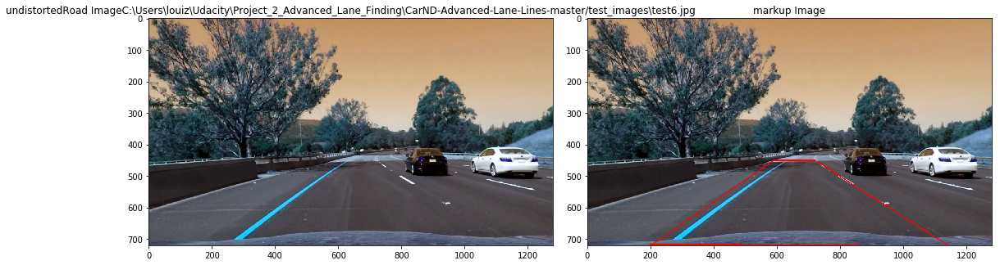

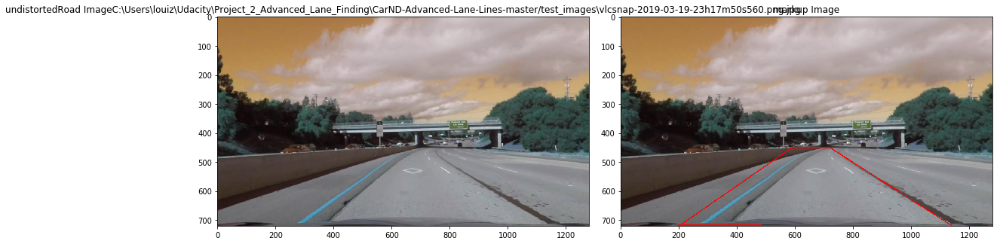

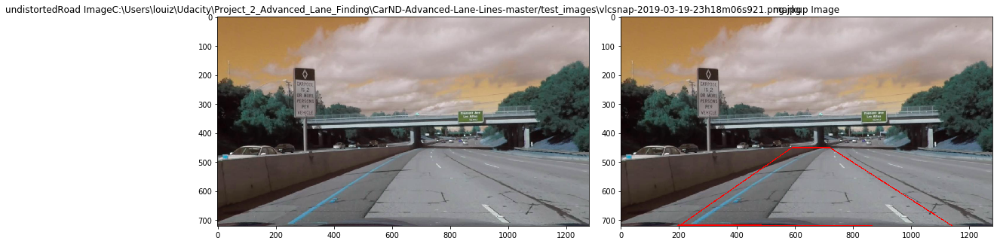

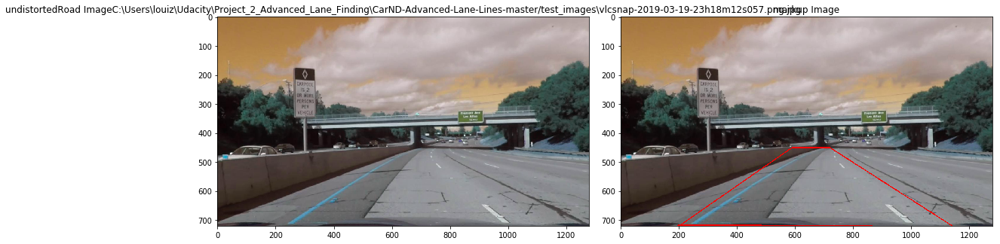

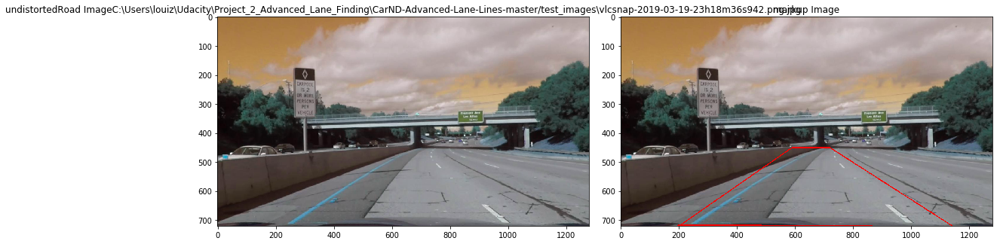

In [92]:
# markup multiple images with lines -> note using the undistorted images still
import os

# map with gridsroadImagesNames = glob.glob('./test_images/*.jpg')
roadImagesNames = glob.glob(os.getcwd() + '/test_images/*.jpg')
for fname in roadImagesNames: 
    orignalImg = cv2.imread(fname)
    undistortedRoad = cv2.undistort(orignalImg, mtx, dist, None, mtx)
    binaryImage = thresholdHLS(undistortedRoad, s_thresh=(170, 255), sx_thresh=(30, 255))
    gridImage = grid_image(binaryImage, 100, 150)
    
    tempImage = undistortedRoad.copy()
    # 8 vertices to draw a polygon
    left_lane_start = (200,720)
    left_lane_end = (590,450)
    right_lane_end  = (1150, 725)
    right_lane_start = (720, 450)
    tempImage = cv2.line(tempImage, left_lane_start, left_lane_end,(255,0,0), 2)
    tempImage = cv2.line(tempImage, left_lane_end, right_lane_start,(255,0,0), 2)
    tempImage = cv2.line(tempImage, right_lane_start, right_lane_end,(255,0,0), 2)
    tempImage = cv2.line(tempImage, left_lane_start, right_lane_end,(255,0,0), 10)

    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
    f.tight_layout()
    ax1.imshow(undistortedRoad, cmap='gray')
    ax1.set_title('undistortedRoad Image' + fname, fontsize=12)
    ax2.imshow(tempImage, cmap='gray')
    ax2.set_title('markup Image', fontsize=12)   
   # ax3.imshow(gridImage, cmap='gray')
    #ax3.set_title('binaryImage' + fname, fontsize=10)



ok seems we have fitted visually roughly -> prob best to actually draw lines and use the polyfit function for each!


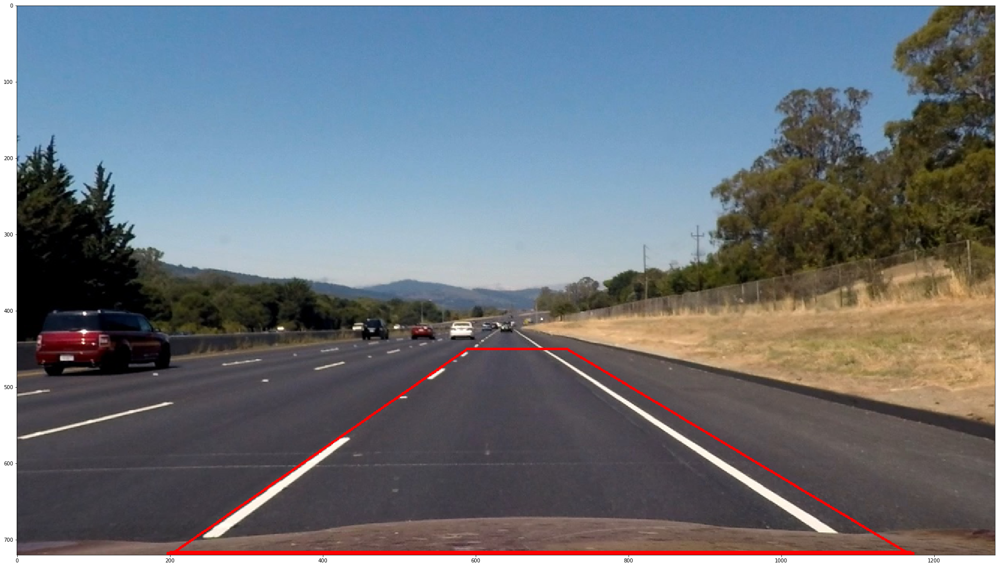

In [93]:
img=mpimg.imread('test_images/straight_lines2.jpg')
undistortedRoad = cv2.undistort(img, mtx, dist, None, mtx)

## mark up one sample image with the lines
tempImage = undistortedRoad.copy()

# 8 vertices to draw a polygon
left_lane_start = (200,720)
left_lane_end = (589,450)
right_lane_end  = (1170, 720)
right_lane_start = (720, 450)
tempImage = cv2.line(tempImage, left_lane_start, left_lane_end,(255,0,0), 2)
tempImage = cv2.line(tempImage, left_lane_end, right_lane_start,(255,0,0), 2)
tempImage = cv2.line(tempImage, right_lane_start, right_lane_end,(255,0,0), 2)
tempImage = cv2.line(tempImage, left_lane_start, right_lane_end,(255,0,0), 10)
fig, ax = plt.subplots(figsize=(40, 20))
ax.imshow(tempImage)

In [94]:
#src = np.float32([
#    [585, 455],[705, 455],[1130, 720],[190, 720]
#]


1280
720


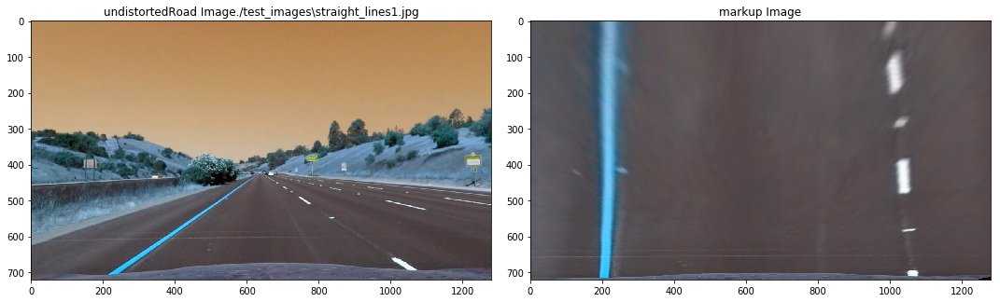

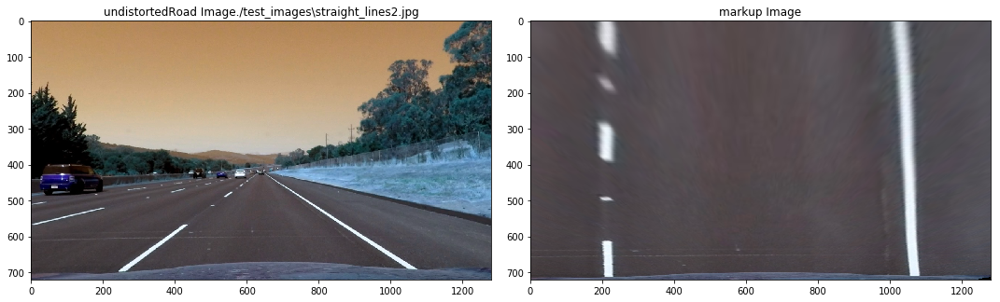

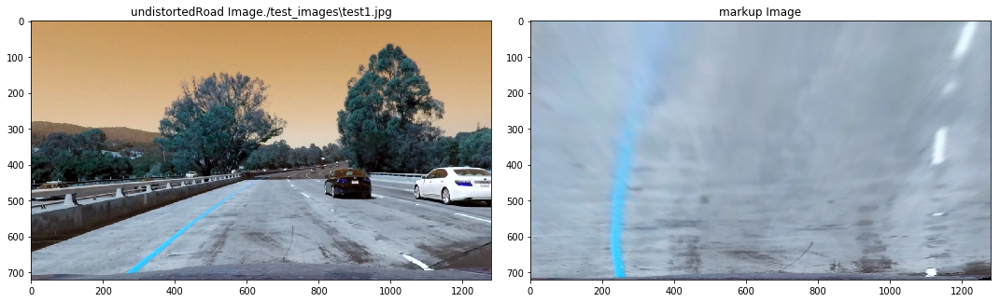

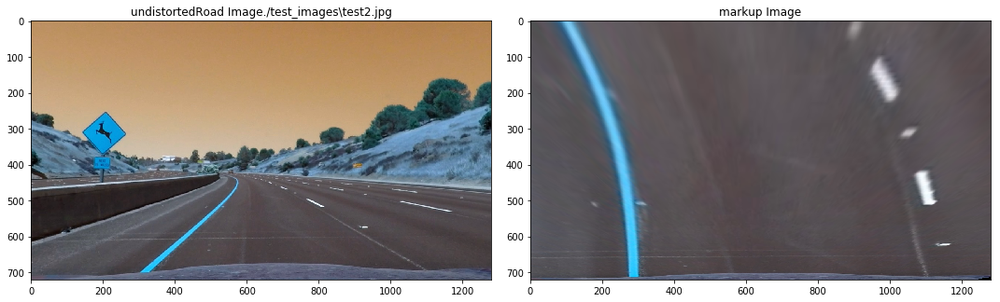

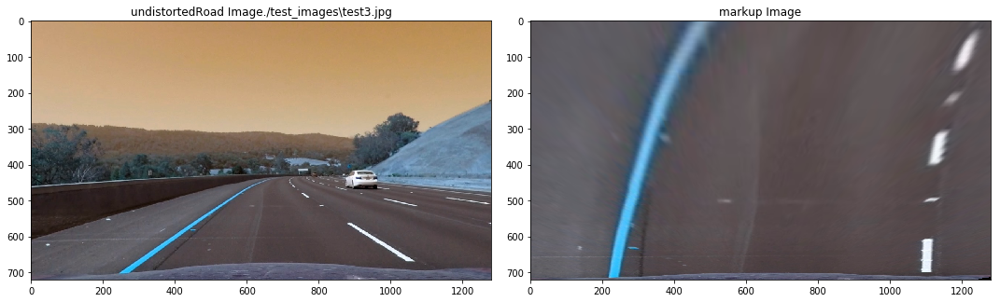

...

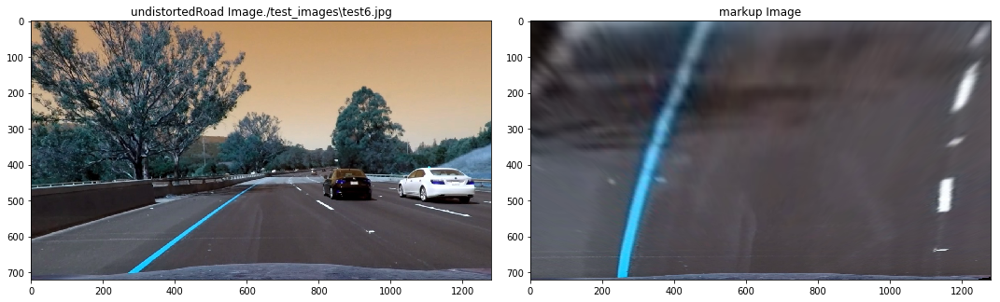

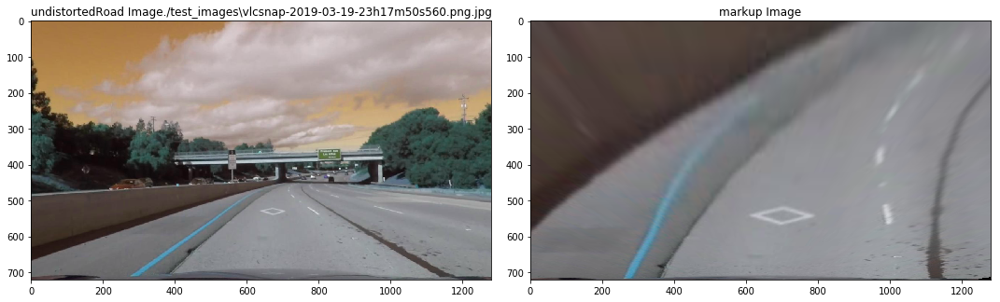

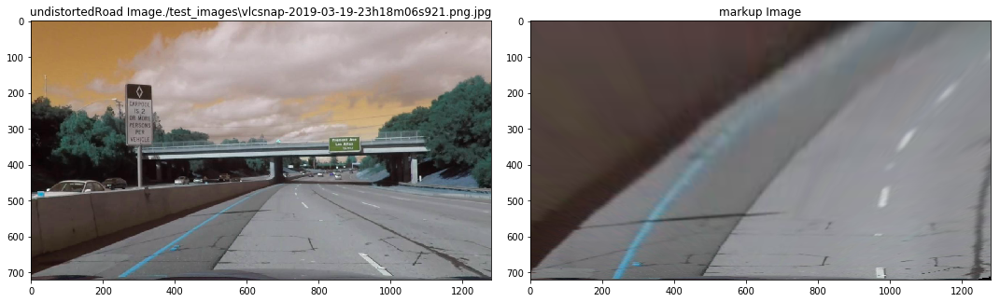

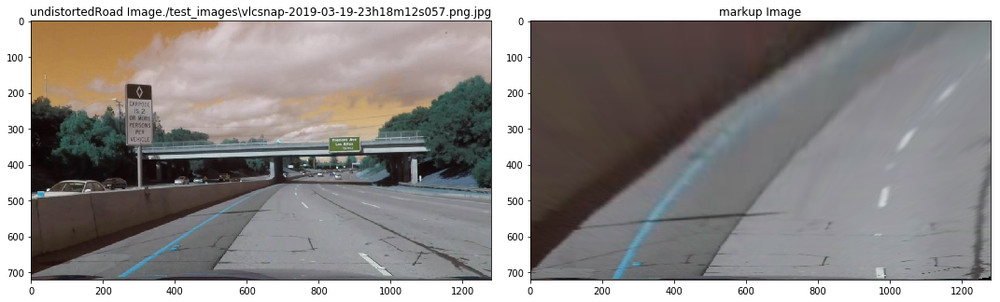

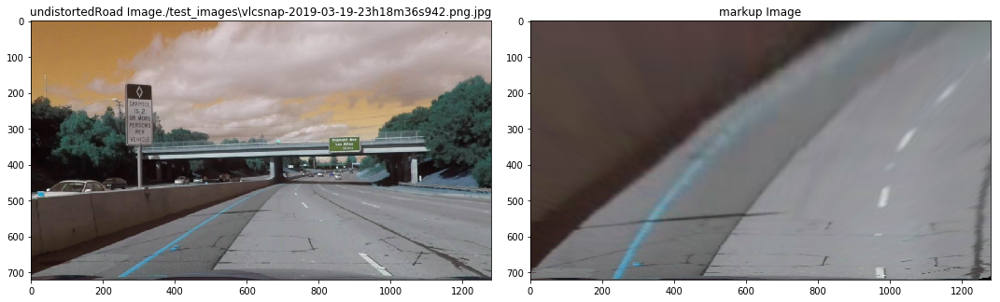

In [95]:

# co-ordinates for the lane markings
# note here that I am adding a margin there... and also using the distorted image as a reference
src = np.float32([
    #[589, 450],[720, 450],[1130, 720],[190, 720]
    [585, 455],[705, 455], [1130, 720], [190, 720]
])

pixel_offset = 190   
nx = img.shape[1]
ny = img.shape[0]

print(nx)
print(ny)

dst = np.float32([
    [pixel_offset, 0],
    [nx - pixel_offset, 0],
    [nx -  pixel_offset, ny], 
    [pixel_offset, ny]
])


# src = np.float32([
#     [490, 482],
#     [810, 482],
#     [1250, 720],
#     [40, 720]
# ])
# dst = np.float32([
#     [0, 0],
#     [1280, 0],
#     [1250, 720],
#     [40, 720]
# ])

#print(dst)
roadImagesNames = glob.glob('./test_images/*.jpg')
for fname in roadImagesNames: 
    orignalImg = cv2.imread(fname)
    undistortedRoad = cv2.undistort(orignalImg, mtx, dist, None, mtx)
    binaryImage = thresholdHLS(undistortedRoad, s_thresh=(130, 255), sx_thresh=(40, 100))

    M = cv2.getPerspectiveTransform(src,dst)   
    # inverse transform..
    Minv = cv2.getPerspectiveTransform(dst,src)
    
    birdseye = cv2.warpPerspective(undistortedRoad, M, (nx,ny))
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
    f.tight_layout()
    ax1.imshow(undistortedRoad, cmap='gray')
    ax1.set_title('undistortedRoad Image' + fname, fontsize=12)
    ax2.imshow(birdseye, cmap='gray')
    ax2.set_title('markup Image', fontsize=12)  

#birdsEyeTransform = pickle.dump(pickle.dump({'mtx': mtx, 'dist': dist },open('camera_cal/pickled_data/birds_eye_Transform.p', 'wb')))
birdsEyeTransform = pickle.dump({'M': M, 'Minv': Minv },open('camera_cal/pickled_data/birds_eye_Transform.p', 'wb'))

Ok i can see this will probably not work effectively for all cases as I have defined a static variable above for the lines.

Ideally i will
*1 find the right and left lines (using thresholding)
*2 fit the lane lines using a polyfit etc function -> just like the first lane detection algorithm that was done
*3 find the vertices at the horizon and at the car bonnet
*4 define this as a the src image lane marking coefficients
*5 apply to each image

this may not work -> it may be too slow....should try out

In [96]:
print(M)
print("Minv     : ", Minv)

[[-6.98798711e-01 -1.49809552e+00  1.07272781e+03]
 [-1.33226763e-14 -1.98300615e+00  9.02267800e+02]
 [-1.99493200e-17 -2.40257838e-03  1.00000000e+00]]
Minv     :  [[ 1.33333333e-01 -7.78812057e-01  5.59666667e+02]
 [-1.55431223e-15 -5.04284870e-01  4.55000000e+02]
 [-1.30104261e-18 -1.21158392e-03  1.00000000e+00]]


#  The Goal of this Project
In this project, your goal is to write a software pipeline to identify the lane boundaries in a video from a front-facing camera on a car. The camera calibration images, test road images, and project videos are available in the project repository or in the repository folder included with the workspace.

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
## * Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


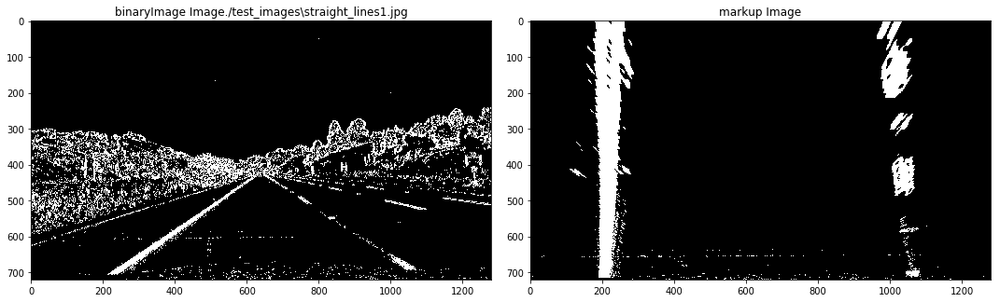

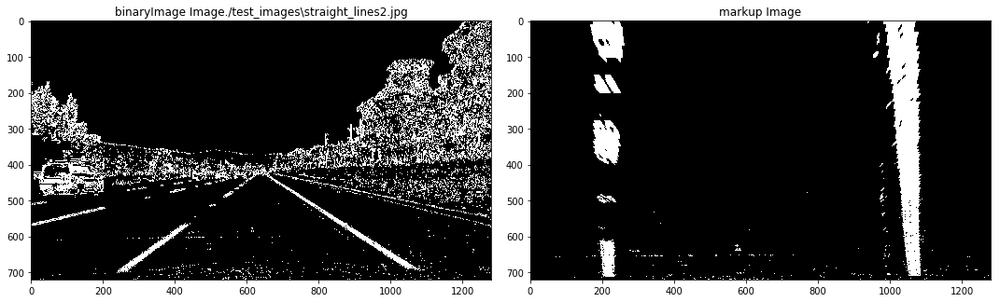

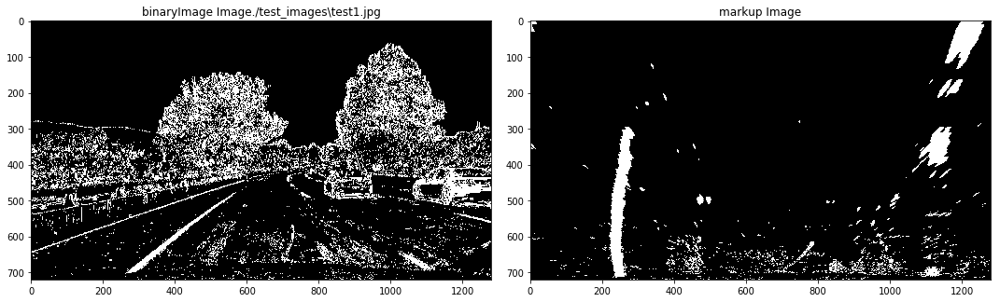

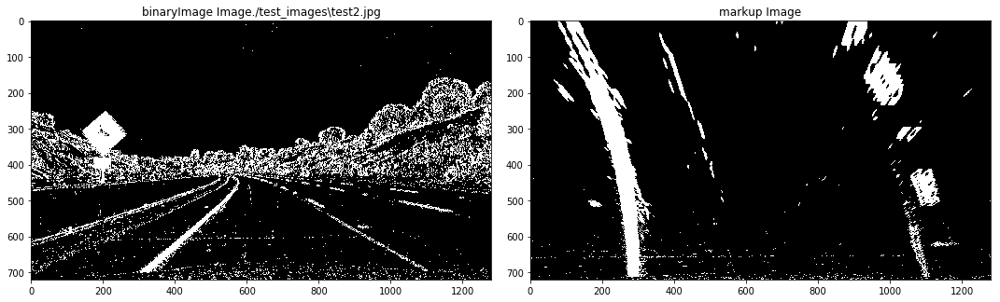

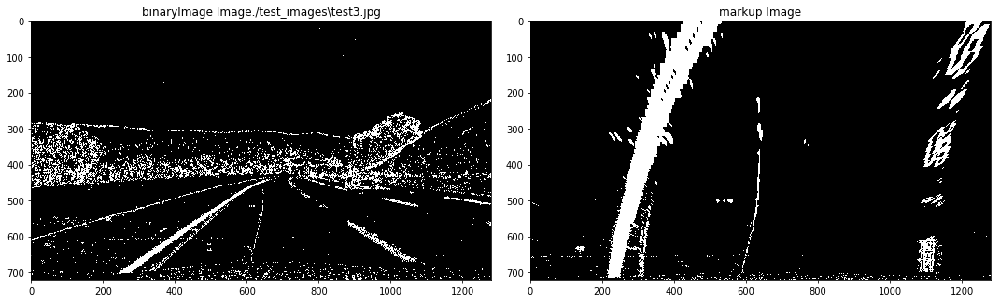

...

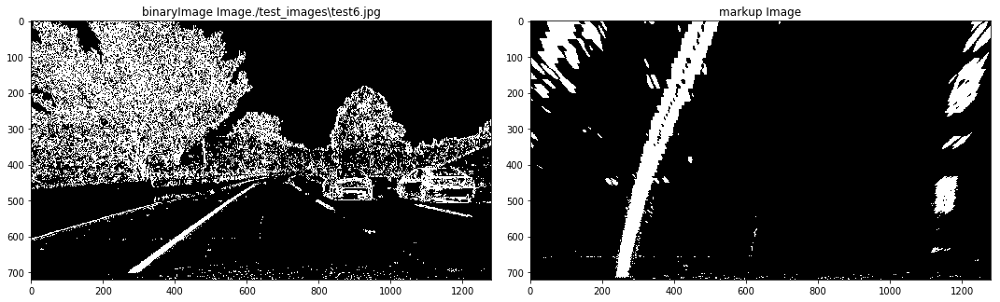

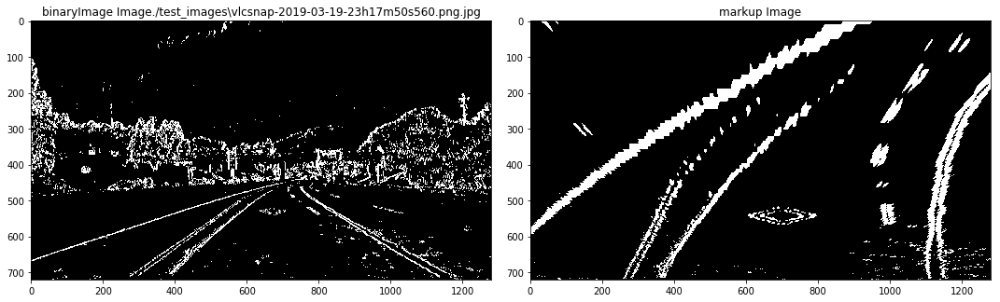

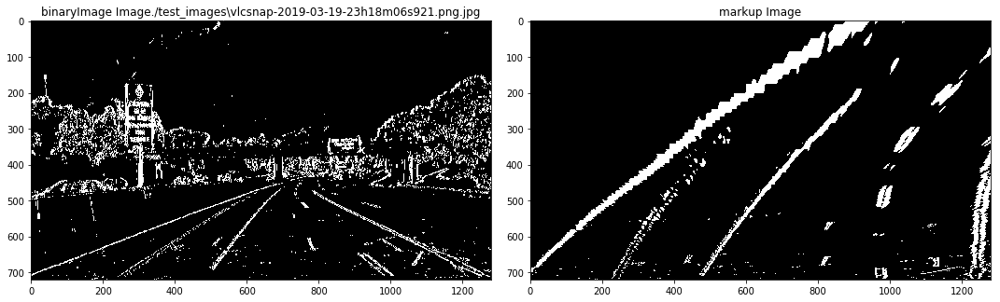

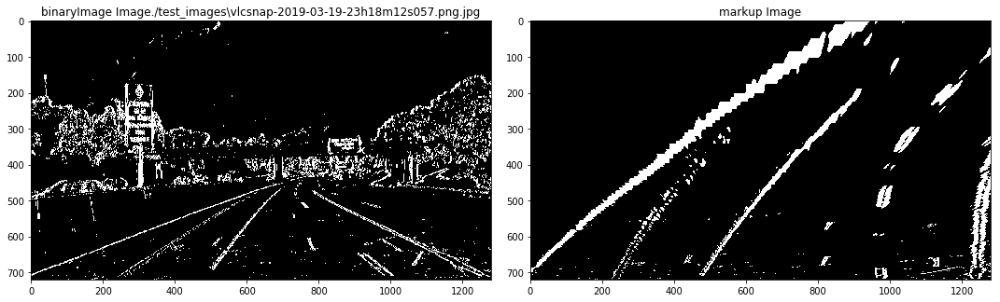

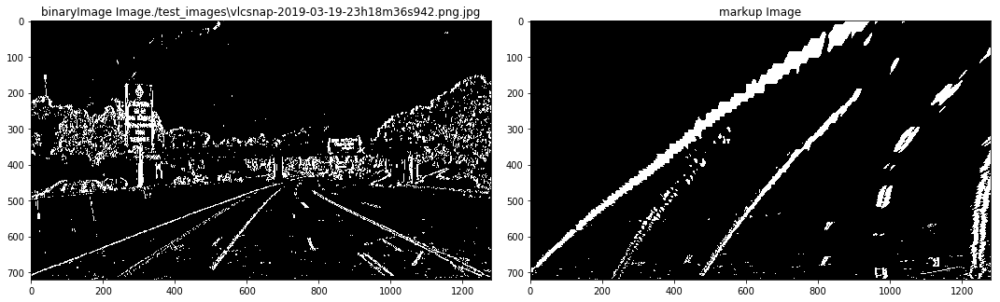

In [97]:
roadImagesNames = glob.glob('./test_images/*.jpg')
for fname in roadImagesNames: 
    orignalImg = cv2.imread(fname)
    undistortedRoad = cv2.undistort(orignalImg, mtx, dist, None, mtx)
    binaryRoadImage = thresholdHLS(undistortedRoad, s_thresh=(170, 255), sx_thresh=(10, 120))
    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst,src)
    birdseye = cv2.warpPerspective(binaryRoadImage, M, (nx,ny))
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
    f.tight_layout()
    ax1.imshow(binaryRoadImage, cmap='gray')
    ax1.set_title('binaryImage Image' + fname, fontsize=12)
    ax2.imshow(birdseye, cmap='gray')
    ax2.set_title('markup Image', fontsize=12)  

#birdsEyeTransform = pickle.dump({'mtx': mtx, 'dist': dist },open('camera_cal/pickled_data/birds_eye.p', 'wb'))


In [98]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 50
    # Set minimum number of pixels found to recenter window
    minpix = 100

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        
        ### TO-DO: Find the four below boundaries of the window ###
        # look at the current window and include the margin..
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        
        good_left_inds = ((nonzeroy >= win_y_low) &
                          (nonzeroy < win_y_high) & 
                          (nonzerox >= win_xleft_low) &
                          (nonzerox < win_xleft_high)).nonzero()[0] 
        
        good_right_inds = ((nonzeroy >= win_y_low) & 
                           (nonzeroy < win_y_high) &
                           (nonzerox >= win_xright_low) &
                           (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        #if there is are a nonzero pixels within the window minimum number of pixels found to recenter window
        if len(good_left_inds) > minpix:  
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))     
        
    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        print("didnt work")
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    return leftx, lefty, rightx, righty, out_img

def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit` ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')

    return (out_img, left_fitx, right_fitx, left_fit, right_fit, ploty )


left_fit  [ 4.19309506e-05 -3.03275760e-02  2.16813239e+02]
right_fit  [-1.53303469e-05  6.07158870e-02  1.03015799e+03]


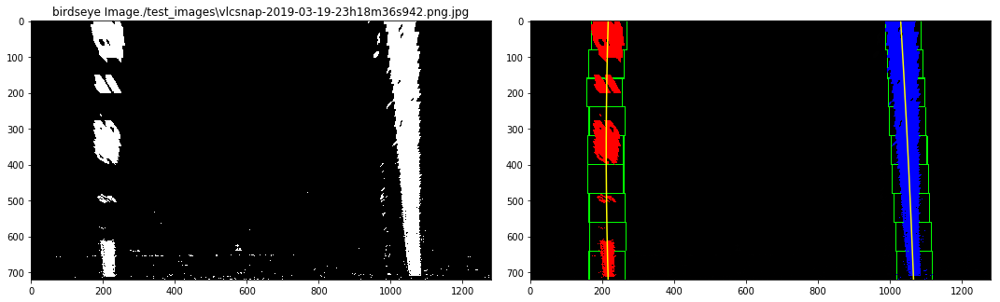

In [99]:
img=mpimg.imread('test_images/straight_lines2.jpg')

undistortedRoad = cv2.undistort(img, mtx, dist, None, mtx)
binaryRoadImage = thresholdHLS(undistortedRoad, s_thresh=(90, 255), sx_thresh=(10, 120))
M = cv2.getPerspectiveTransform(src,dst)   
birdseye = cv2.warpPerspective(binaryRoadImage, M, (nx,ny))
out_img, left_fitx, right_fitx, left_fit, right_fit, ploty = fit_polynomial(birdseye)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
f.tight_layout()
ax1.imshow(birdseye, cmap='gray')
ax1.set_title('birdseye Image' + fname, fontsize=12)
ax2.imshow(out_img, cmap='gray')
ax2.plot(left_fitx, ploty, color='yellow')
ax2.plot(right_fitx, ploty, color='yellow')

#ax2.plot(right_fitx[2],right_fitx,  color='yellow')
#ax2.set_title('windowImage Image' + fname, fontsize=12)
 
print("left_fit " , left_fit)
print("right_fit ", right_fit)

left_fit  ./test_images\straight_lines1.jpg   [-1.03754122e-05 -2.15871189e-03  2.19427240e+02]
right_fit ./test_images\straight_lines1.jpg   [2.01772053e-06 7.82052606e-02 1.00311873e+03] 

left_fit  ./test_images\straight_lines2.jpg   [ 3.87466842e-05 -2.82375387e-02  2.16424826e+02]
right_fit ./test_images\straight_lines2.jpg   [-1.53232133e-05  6.05707017e-02  1.03015168e+03] 

left_fit  ./test_images\test1.jpg   [ 3.85254621e-04 -4.64528053e-01  3.80913591e+02]
right_fit ./test_images\test1.jpg   [ 2.74943316e-04 -3.34727101e-01  1.21857425e+03] 

left_fit  ./test_images\test2.jpg   [-3.51699693e-04  4.89329388e-01  1.19594826e+02]
right_fit ./test_images\test2.jpg   [-5.97007098e-04  6.46791466e-01  9.17866697e+02] 

left_fit  ./test_images\test3.jpg   [ 3.59068633e-04 -4.61976256e-01  4.31091756e+02]
right_fit ./test_images\test3.jpg   [ 2.40931219e-04 -3.48147216e-01  1.22907941e+03] 

left_fit  ./test_images\test4.jpg   [ 2.31633400e-04 -2.69235688e-01  3.47921349e+02]
right_f

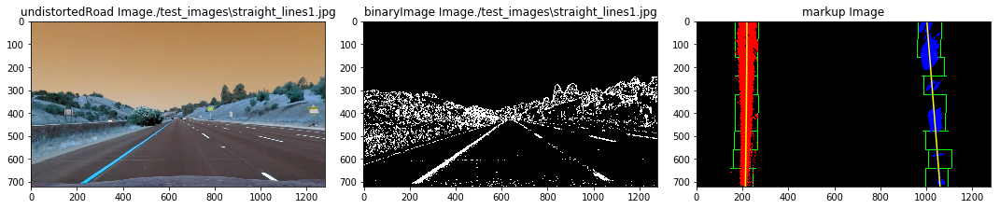

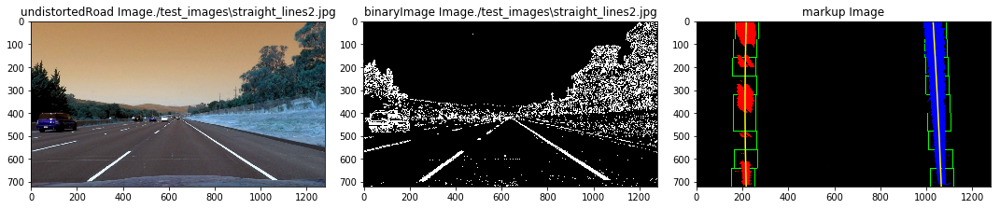

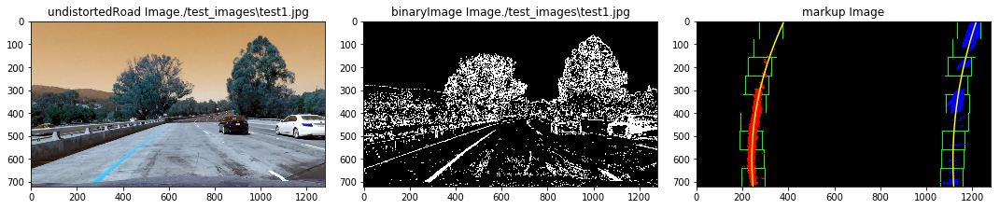

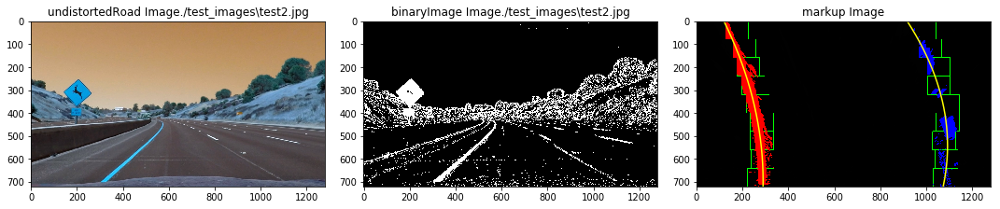

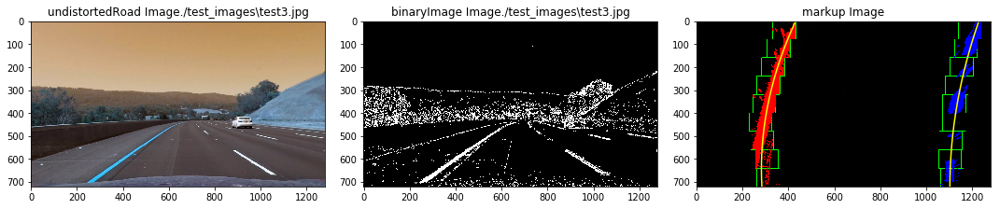

...

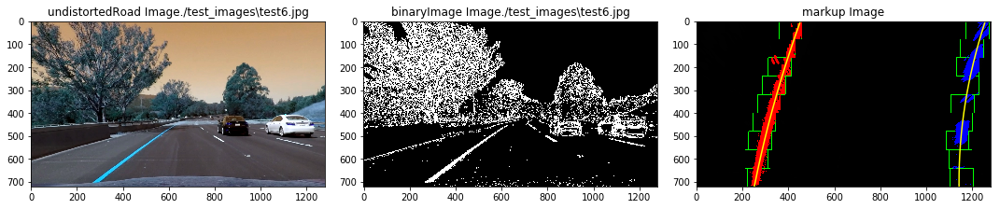

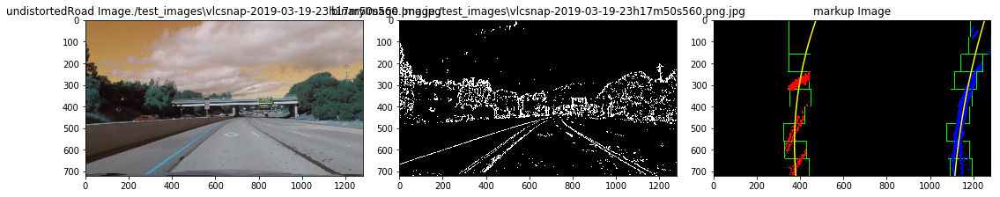

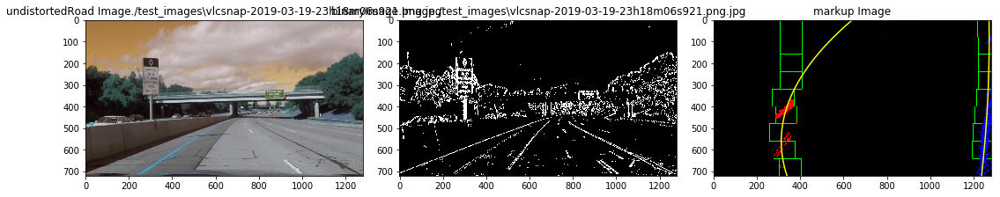

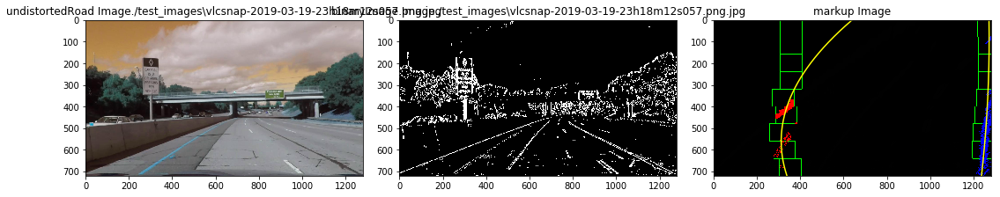

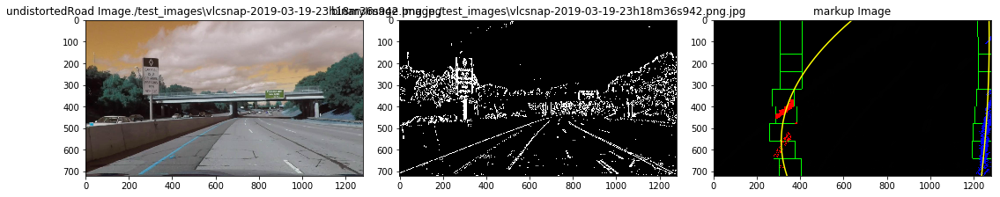

In [100]:
roadImagesNames = glob.glob('./test_images/*.jpg')



for fname in roadImagesNames: 
    orignalImg = cv2.imread(fname)
    undistortedRoad = cv2.undistort(orignalImg, mtx, dist, None, mtx)
    binaryRoadImage = thresholdHLS(undistortedRoad, s_thresh=(160, 255), sx_thresh=(10, 255))
    M = cv2.getPerspectiveTransform(src,dst)   
    birdseye = cv2.warpPerspective(binaryRoadImage, M, (nx,ny))
    out_img, left_fitx, right_fitx, left_fit, right_fit, ploty = fit_polynomial(birdseye)
    
    print("left_fit " , fname ," " , left_fit)
    print("right_fit" , fname , " " , right_fit,"\n")

    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 10))
    f.tight_layout()
    ax1.imshow(undistortedRoad, cmap='gray')
    ax1.set_title('undistortedRoad Image' + fname, fontsize=12)
    ax2.imshow(binaryRoadImage, cmap='gray')
    ax2.set_title('binaryImage Image' + fname, fontsize=12)
    ax3.imshow(out_img, cmap='gray')
    ax3.set_title('markup Image', fontsize=12) 
    ax3.plot(left_fitx, ploty, color='yellow')
    ax3.plot(right_fitx, ploty, color='yellow')
    



In [101]:



def fit_poly(img_shape, leftx, lefty, rightx, righty):
     ### Fitting a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty



def search_around_poly(binary_warped):
    # HYPERPARAMETER
    # Width of the margin around the previous polynomial to search
    margin = 90

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    
    return result, ploty, right_fitx, left_fitx


[ 4.19709859e-04 -4.79568379e-01  1.11522544e+03]
[ 2.23090058e-04 -3.90812851e-01  4.78139852e+02]
left_fit  ./test_images\vlcsnap-2019-03-19-23h18m36s942.png.jpg   [ 2.23090058e-04 -3.90812851e-01  4.78139852e+02]
right_fit ./test_images\vlcsnap-2019-03-19-23h18m36s942.png.jpg   [ 4.19709859e-04 -4.79568379e-01  1.11522544e+03] 



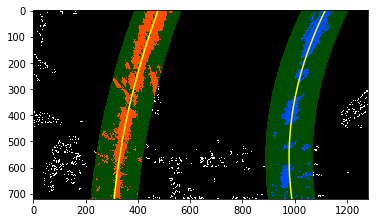

In [102]:
# what I need to do is segment the first "window" using sliding window approach -> 
# using teh historgram to find where the line starting points




img=mpimg.imread('warped-example.jpg')
left_fit = np.array( [ 2.23090058e-04, -3.90812851e-01,  4.78139852e+02])
right_fit= np.array(   [ 4.19709859e-04, -4.79568379e-01,  1.11522544e+03])

result, ploty, right_fitx, left_fitx = search_around_poly(img)
print(right_fit)
print(left_fit)

plt.imshow(result)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')

print("left_fit " , fname ," " , left_fit)
print("right_fit" , fname , " " , right_fit,"\n")

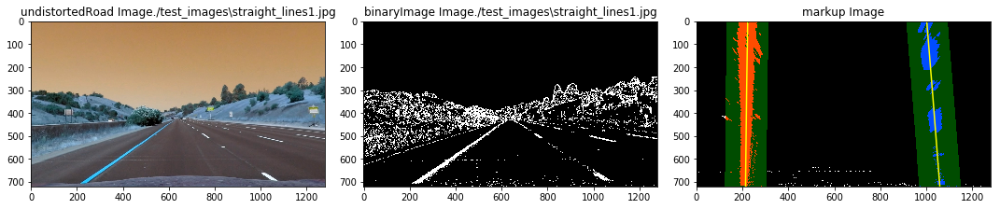

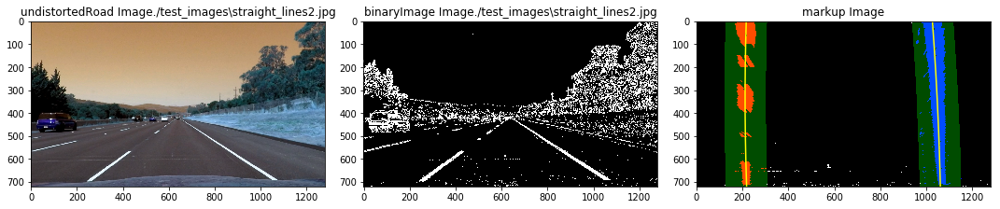

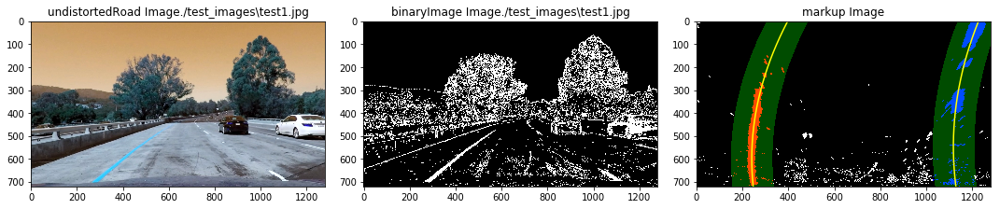

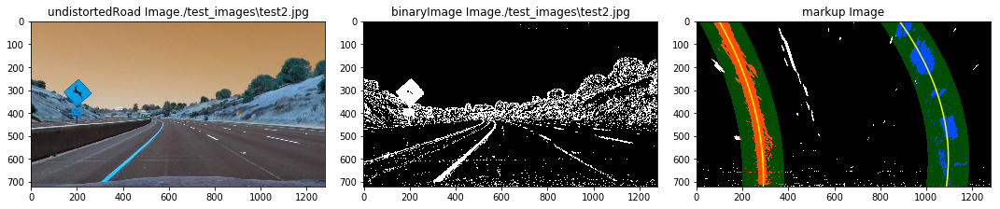

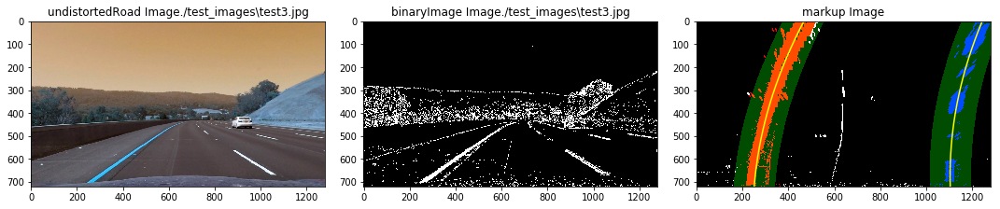

...

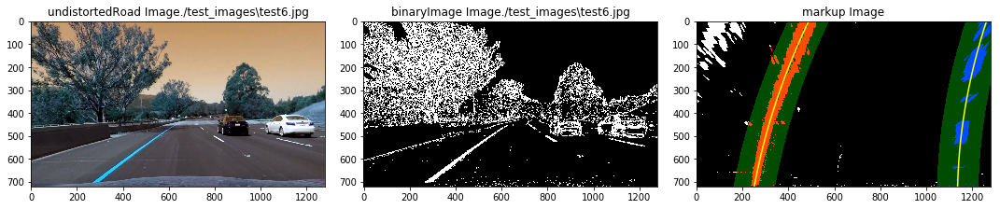

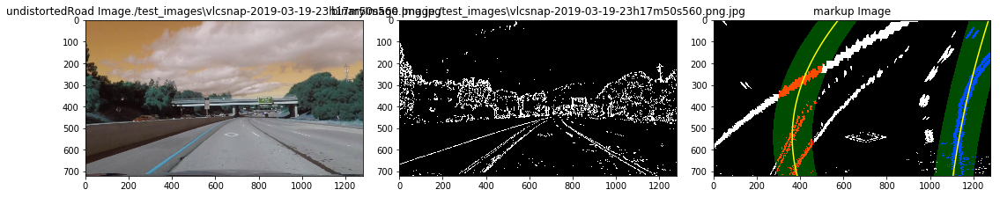

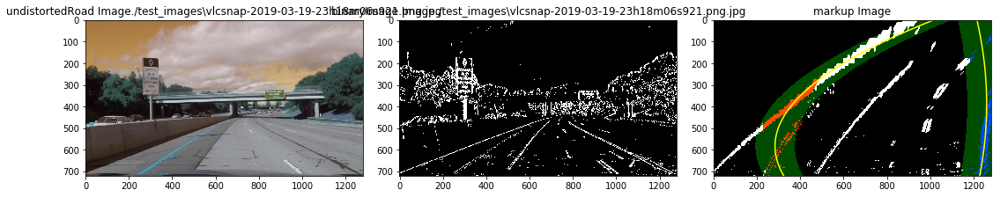

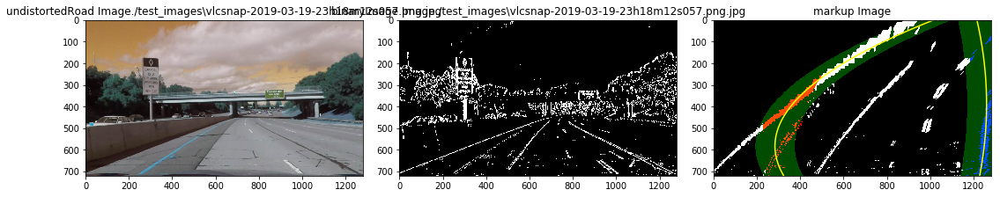

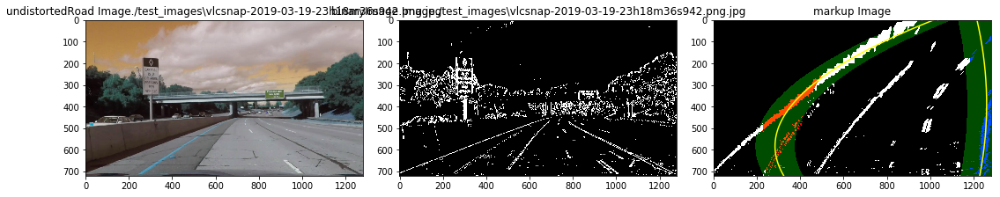

In [103]:
roadImagesNames = glob.glob('./test_images/*.jpg')

for fname in roadImagesNames: 
    orignalImg = cv2.imread(fname)
    undistortedRoad = cv2.undistort(orignalImg, mtx, dist, None, mtx)
    binaryRoadImage = thresholdHLS(undistortedRoad, s_thresh=(160, 255), sx_thresh=(10, 255))
    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst,src)
    birdseye = cv2.warpPerspective(binaryRoadImage, M, (nx,ny))
    
    # perform this only to get the left_fit and right_fit coefficients
    out_img, left_fitx, right_fitx, left_fit, right_fit, ploty = fit_polynomial(birdseye)    
    result, ploty, right_fitx, left_fitx= search_around_poly(birdseye)    

    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 10))
    f.tight_layout()
    ax1.imshow(undistortedRoad, cmap='gray')
    ax1.set_title('undistortedRoad Image' + fname, fontsize=12)
    
    ax2.imshow(binaryRoadImage, cmap='gray')
    ax2.set_title('binaryImage Image' + fname, fontsize=12)
    
    ax3.imshow(result, cmap='gray')
    ax3.set_title('markup Image', fontsize=12) 
    ax3.plot(left_fitx, ploty, color='yellow')
    ax3.plot(right_fitx, ploty, color='yellow')


In [104]:
#comments on image 4 - probably can still play around with the thresholding a bit more, try with a lrger sample size.
# good idea to get output RGB of pixel points to actually find the variation in the white and yellow lines...


## to do include convolution approach for sliding window..


In [105]:
def window_mask( img_ref, center, level, width = 50, height = 80):
 
    #output = np.zeros_like(img_ref)
    #output[int(image_width - (level + 1) * height):int(image_width - level * height),
    #      max(0,int(center - width / 2)):min(int(center + width/2), image_height)] = 1
    #print("center", center)
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-( level +1)*height):int(img_ref.shape[0]- level * height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    #print("mask", output)
    return output

def find_window_centroids(image, window_width, window_height, window_margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(image[int(3 * image.shape[0] / 4):,: int(image.shape[1] / 2)], axis=0)
    l_center = np.argmax(np.convolve(window, l_sum))- window_width / 2
    r_sum = np.sum(image[int(3 * image.shape[0] / 4):, int(image.shape[1] / 2 ):], axis=0)
    r_center = np.argmax(np.convolve(window, r_sum)) - window_width / 2 + int(image.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0] / window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(image[int(image.shape[0]-(level + 1)* window_height):int(image.shape[0] - level * window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)

        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center + offset - window_margin, 0))
        l_max_index = int(min(l_center + offset + window_margin, image.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index]) + l_min_index - offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center + offset - window_margin,0))
        r_max_index = int(min(r_center + offset + window_margin,image.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index]) + r_min_index-offset
        # Add what we found for that layer
        window_centroids.append((l_center, r_center))
        
    #print("window_centroids ",window_centroids)   


    # start the drawing process       
    if len(window_centroids) > 0:
        # Points used to draw all the left and right windows
        l_points = np.zeros_like(image)
        r_points = np.zeros_like(image)

        # Go through each level and draw the windows 	
        for level in range(0,len(window_centroids)):
            
            # Window_mask is a function to draw window areas
            #window_mask( img_ref, center, level, width = 50, height = 80)
            l_mask = window_mask(image, window_centroids[level][0], level, window_width, window_height)
            r_mask = window_mask(image, window_centroids[level][1], level, window_width, window_height)
            
            #print("l_mask",l_mask)
            #print("length of mask", l_mask.shape)
            
            #print("l_points",l_points)
            #print("length of points", l_points.shape)

            # Add graphic points from window mask here to total pixels found
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255
        
        # Draw the results
        template = np.array(r_points + l_points,np.uint8) # add both left and right window pixels together        
        zero_channel = np.zeros_like(template) # create a zero color channel        
        template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green        
        warpage = np.dstack((image, image, image))*255 # making the original road pixels 3 color channels
            
        # overlay the orignal road image with window results 
        image_output = cv2.addWeighted(warpage, 1, template, 1, 0.0)  

        #If no window centers found, just display orginal road image
    else:
        image_output = np.array(cv2.merge((image,image,image)),np.uint8)
    return image_output
    



Text(0.5, 1.0, 'centroids Image./test_images\\vlcsnap-2019-03-19-23h18m36s942.png.jpg')

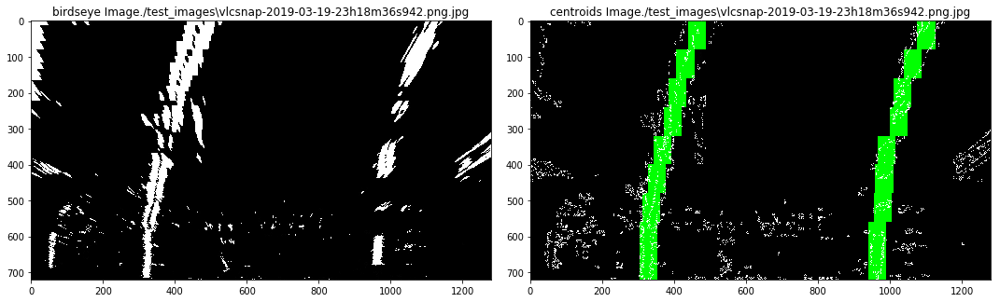

In [106]:
birdseye =  mpimg.imread("./warped-example.jpg")
image_output = find_window_centroids(birdseye, window_width = 50, window_height = 80, window_margin=100)

#plt.imshow(image_output)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
f.tight_layout()
ax1.imshow(birdseye, cmap='gray')
ax1.set_title('birdseye Image' + fname, fontsize=12)
ax2.imshow(image_output, cmap='gray')
ax2.set_title("centroids Image" + fname, fontsize=12)
#plt.imshow(image_output)
#plt.title('window fitting results')
#plt.show()

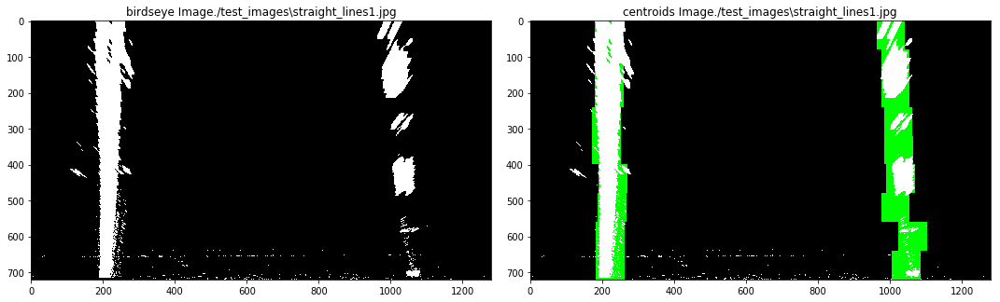

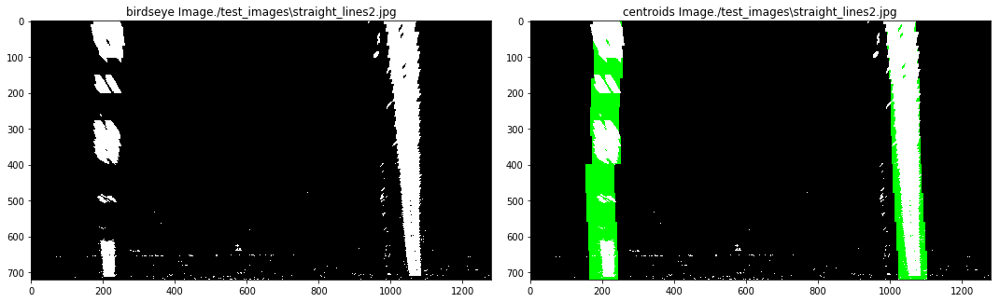

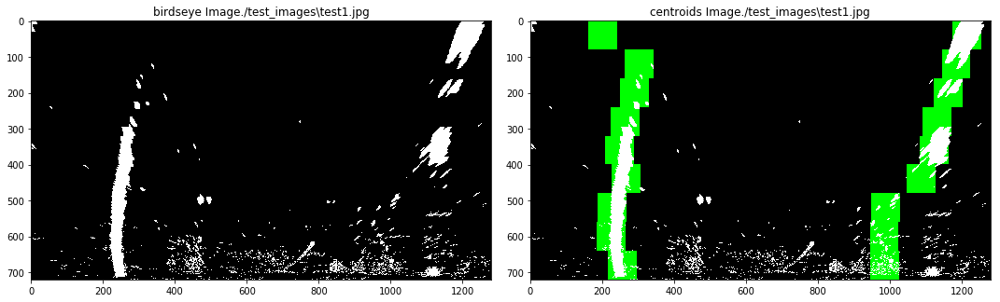

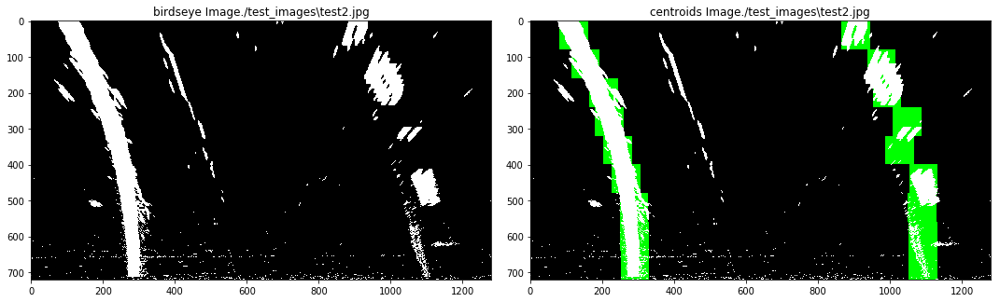

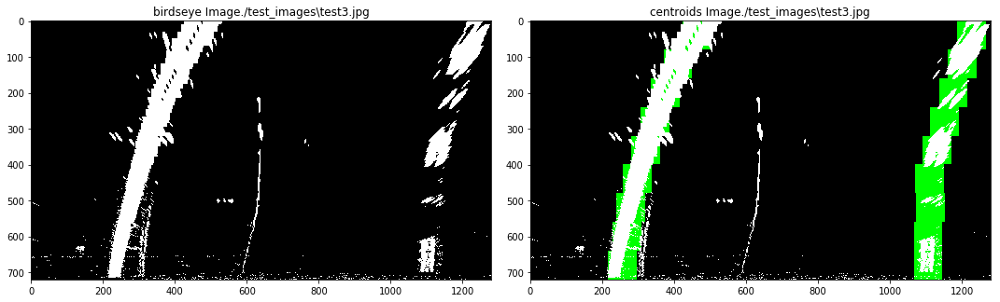

...

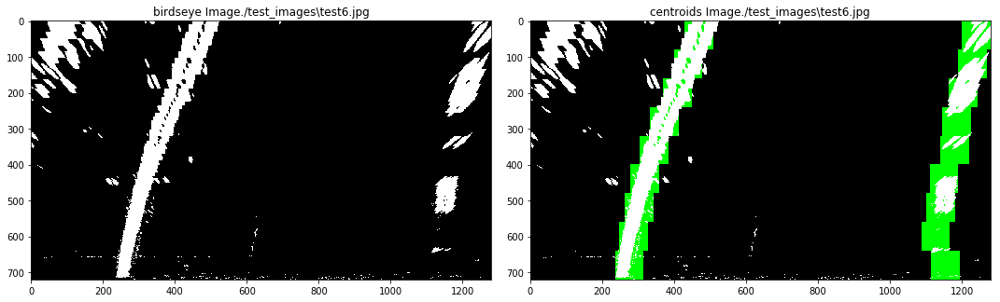

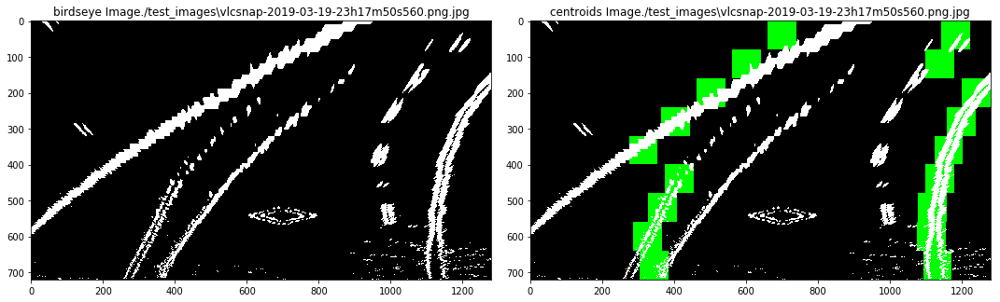

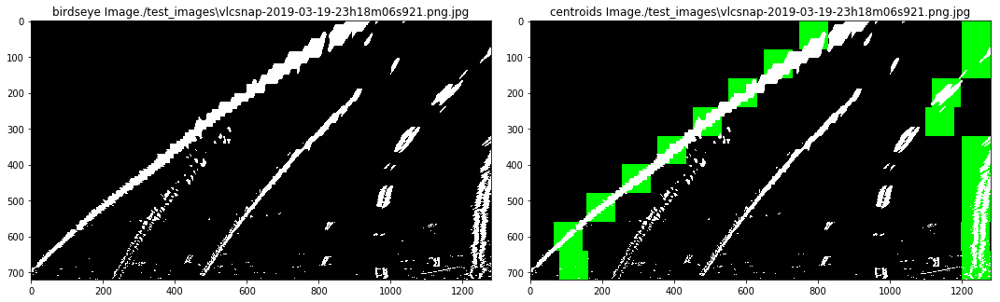

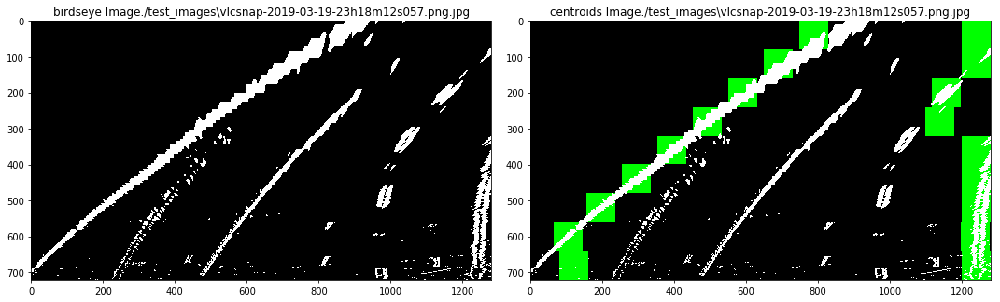

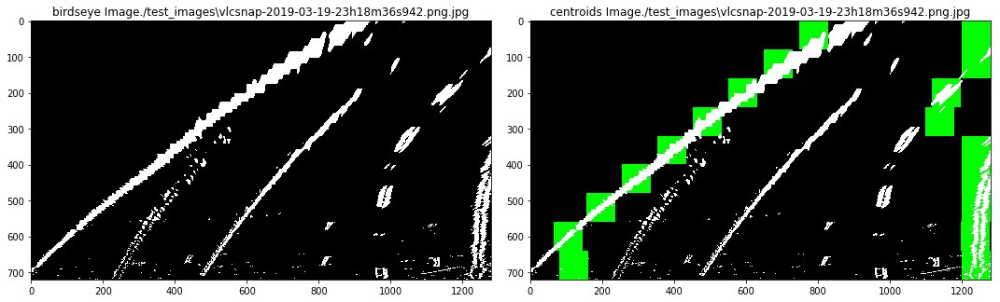

In [107]:
roadImagesNames = glob.glob('./test_images/*.jpg')
for fname in roadImagesNames: 
    orignalImg = cv2.imread(fname)
    undistortedRoad = cv2.undistort(orignalImg, mtx, dist, None, mtx)
    binaryRoadImage = thresholdHLS(undistortedRoad, s_thresh=(160, 255), sx_thresh=(10, 255))
    M = cv2.getPerspectiveTransform(src,dst)  
    Minv = cv2.getPerspectiveTransform(dst,src)
    birdseye = cv2.warpPerspective(binaryRoadImage, M, (nx,ny))    
    image_output = find_window_centroids(birdseye, window_width = 80, window_height = 80, window_margin=100)
    
    #plt.imshow(image_output)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
    f.tight_layout()
    ax1.imshow(birdseye, cmap='gray')
    ax1.set_title('birdseye Image' + fname, fontsize=12)
    ax2.imshow(image_output, cmap='gray')
    ax2.set_title("centroids Image" + fname, fontsize=12)
    #ax2.set_title('window_centroids', fontsize=12) 
    #ax3.plot(left_fitx, ploty, color='yellow')
    #ax3.plot(right_fitx, ploty, color='yellow')


this isn't good enough when there is alot of of noise in the image (that is non-lane markings)

#  The Goal of this Project
In this project, your goal is to write a software pipeline to identify the lane boundaries in a video from a front-facing camera on a car. The camera calibration images, test road images, and project videos are available in the project repository or in the repository folder included with the workspace.

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
# * Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [108]:
print(left_fitx)

print(left_fit)


[1014.47813354 1011.97138394 1009.46893978 1006.97080106 1004.47696776
 1001.98743991  999.50221749  997.0213005   994.54468895  992.07238284
  989.60438215  987.14068691  984.6812971   982.22621272  979.77543379
  977.32896028  974.88679221  972.44892958  970.01537238  967.58612062
  965.16117429  962.74053339  960.32419794  957.91216791  955.50444332
  953.10102417  950.70191045  948.30710217  945.91659933  943.53040191
  941.14850994  938.7709234   936.39764229  934.02866662  931.66399638
  929.30363158  926.94757222  924.59581829  922.24836979  919.90522673
  917.56638911  915.23185692  912.90163016  910.57570884  908.25409296
  905.93678251  903.6237775   901.31507792  899.01068378  896.71059507
  894.41481179  892.12333396  889.83616155  887.55329459  885.27473305
  883.00047696  880.7305263   878.46488107  876.20354128  873.94650692
  871.693778    869.44535452  867.20123646  864.96142385  862.72591667
  860.49471492  858.26781861  856.04522774  853.8269423   851.6129623
  849.4

  321.13603017  321.70766673  322.28360873  322.86385616  323.44840903]
[ 1.04005869e-03 -1.16560630e+00  6.38878393e+02]


In [109]:
def evalPoly(lst, x):
    total = 0
    for power, coeff in enumerate(lst): # starts at 0 by default
        total += (x**power) * coeff
    return total

    #out_img, left_fitx, right_fitx, left_fit, right_fit, ploty = fit_polynomial(birdseye)    
    #result, ploty, right_fitx, left_fitx= search_around_poly(birdseye)      
    
    
# intuitively i don't think this implementaiton is correct.
def measure_curvature_real(left_fit, right_fit):
    '''
    Calculates the curvature of polynomial functions in pixels.
    pass in the left and right lane polynomials
    
    currently does not do this with respect to centre  ->> need to modify....
    '''
    xm_per_pix = 3.7/700
    ym_per_pix =30./720    
    
    #should change this to ref an image........ 
    ploty = np.linspace(0, 719, 720)
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # using the left_fit and right_fit of the actual lane lines
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    #fit the secord order polynomial with real values.
    left_fit_cr = np.polyfit(ploty * ym_per_pix, left_fitx * xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty * ym_per_pix, right_fitx * xm_per_pix, 2)
    
    ##### TO-DO: Implement the calculation of R_curve (radius of curvature) #####
    # using linear approximations and calculus                          
    left_curverad =  ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])    
    
    return left_curverad, right_curverad

In [110]:
## calculate the curvature in pixels of left land and right lane

In [111]:
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

roadImagesNames = glob.glob('./test_images/*.jpg')
for fname in roadImagesNames: 
    #orignalImg = mpimg.imread(fname)
    orignalImg = cv2.imread(fname)
    
    undistortedRoad = cv2.undistort(orignalImg, mtx, dist, None, mtx)
    binaryRoadImage = thresholdHLS(undistortedRoad, s_thresh=(160, 255), sx_thresh=(10, 255))
    
    M = cv2.getPerspectiveTransform(src,dst)         
    Minv = cv2.getPerspectiveTransform(dst,src)
    
    birdseye = cv2.warpPerspective(binaryRoadImage, M, (nx,ny))
    
    # perform this only to get the left_fit and right_fit coefficients
    out_img, left_fitx, right_fitx, left_fit, right_fit, ploty = fit_polynomial(birdseye) 
    
    left_curverad, right_curverad = measure_curvature_real( left_fit, right_fit)
    print(fname, " Radius [m]", left_curverad, right_curverad)
    
    #result, ploty, right_fitx, left_fitx= search_around_poly(birdseye) 


./test_images\straight_lines1.jpg  Radius [m] 48211.94227564026 250253.60266585485
./test_images\straight_lines2.jpg  Radius [m] 12918.95004124462 32702.943252240435
./test_images\test1.jpg  Radius [m] 1313.4570618864104 1828.5971590851536
./test_images\test2.jpg  Radius [m] 1422.2420627622307 894.4416996351468
./test_images\test3.jpg  Radius [m] 1398.669251056974 2075.2899484636414
./test_images\test4.jpg  Radius [m] 2171.7983342366956 1631.492179559408
./test_images\test5.jpg  Radius [m] 3840.0143196815056 1596.3951905231058
./test_images\test6.jpg  Radius [m] 4689.402163011547 2125.090937958182
./test_images\vlcsnap-2019-03-19-23h17m50s560.png.jpg  Radius [m] 1660.6422173569488 3535.9153864171794
./test_images\vlcsnap-2019-03-19-23h18m06s921.png.jpg  Radius [m] 561.3710279402935 5764.48795250859
./test_images\vlcsnap-2019-03-19-23h18m12s057.png.jpg  Radius [m] 561.3710279402935 5764.48795250859
./test_images\vlcsnap-2019-03-19-23h18m36s942.png.jpg  Radius [m] 561.3710279402935 5764.

##  color block the lane (fill left and right)

In [112]:
# first colour block the lane lines

#assuming here it's the birds eye image, we are not unwarping back to the original undistorted view.
def fillLane(birdsEyeWarpedImage, left_fit, right_fit):

    # fill the area between the left line and right line.
    ploty = np.linspace( 0 ,warpedImage.shape[0] - 1,  warpedImage.shape[0])
    
    #create an image to draw on and image to show the lane 
    warp_zero = np.zeros_like(warpedImage).astype(np.uint8)
    #warp_zero = np.dstack((warpedImage, warpedImage, warpedImage))*255
    color_warp = np.zeros_like(warpedImage).astype(np.uint8)
    
    
    # fitting the left and right lanes again (don't know about parsing in the object, will have to verify if optimisation 
    # required..
    
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
    # Generate a polygon to illustrate the search window area and recast the x and y points into usable format for cv2.fillPoly()
    # note this is similar what i did above for search_around_poly(binary_warped): for the lane markings howver I don't want to draw a margin around the lines,
    # want to fill the area.....
    pts_left  = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts  = np.hstack((pts_left, pts_right))
    #print(pts)
    # Draw/ fill the entire lane onto the warped blank image as green.
    overlay = cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))    
    return  cv2.addWeighted(warpedImage, 1, overlay, 0.3, 0)


In [113]:
def fillRoadLane(undistortedImage, left_fit, right_fit):

    # fill the area between the left line and right line.
    ploty = np.linspace( 0, undistortedImage.shape[0] - 1, undistortedImage.shape[0])
    
    #create an image to draw on and image to show the lane 
    warp_zero = np.zeros_like(undistortedImage).astype(np.uint8)
    #warp_zero = np.dstack((warpedImage, warpedImage, warpedImage))*255
    color_warp = np.zeros_like(undistortedImage).astype(np.uint8)
    
    
    # fitting the left and right lanes again (don't know about parsing in the object, will have to verify if optimisation 
    # required..
    
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
    # Generate a polygon to illustrate the search window area and recast the x and y points into usable format for cv2.fillPoly()
    # note this is similar what i did above for search_around_poly(binary_warped): for the lane markings howver I don't want to draw a margin around the lines,
    # want to fill the area.....
    pts_left  = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts  = np.hstack((pts_left, pts_right))
    #print(pts)
    # Draw/ fill the entire lane onto the warped blank image as green.
    
    overlay = cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))    
    #warp the overlay onto the road image
    roadwithOverlay = cv2.warpPerspective(color_warp, Minv, (undistortedImage.shape[1], undistortedImage.shape[0])) 
    return  cv2.addWeighted(undistortedImage, 1, roadwithOverlay, 0.3, 0)


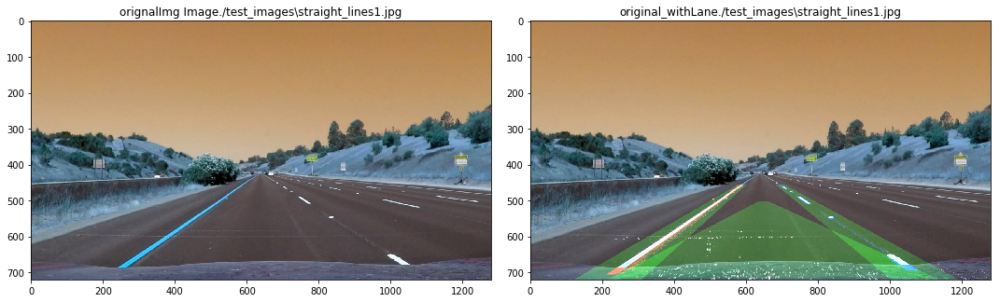

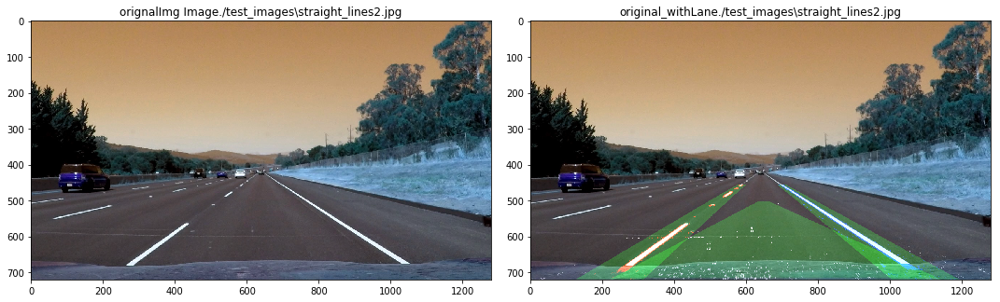

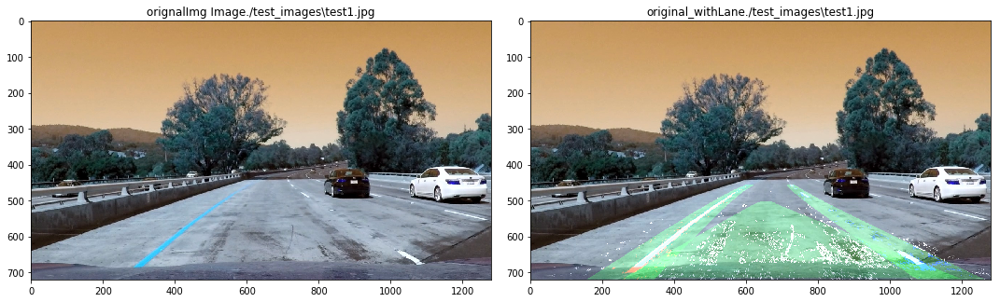

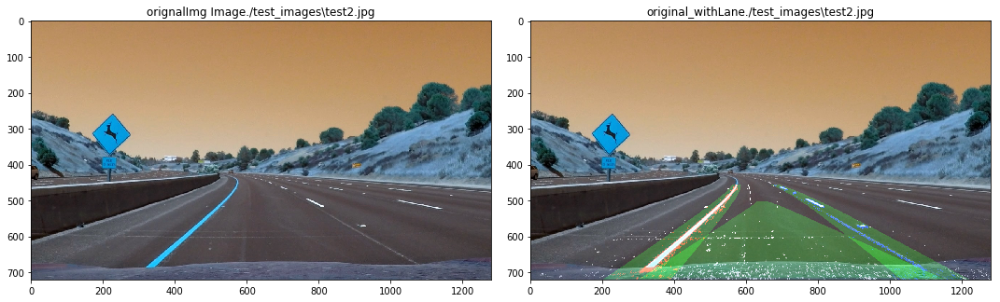

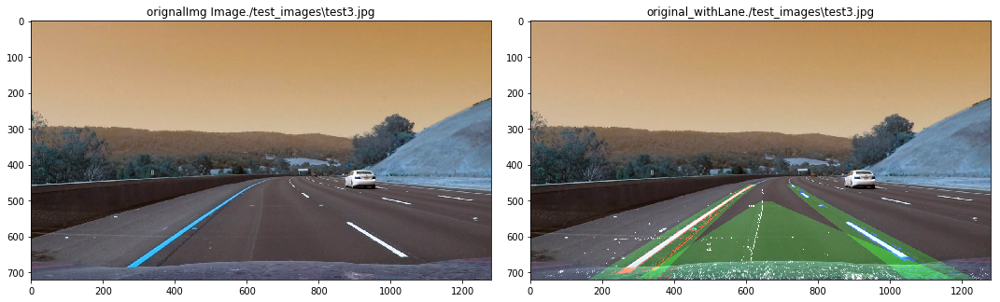

...

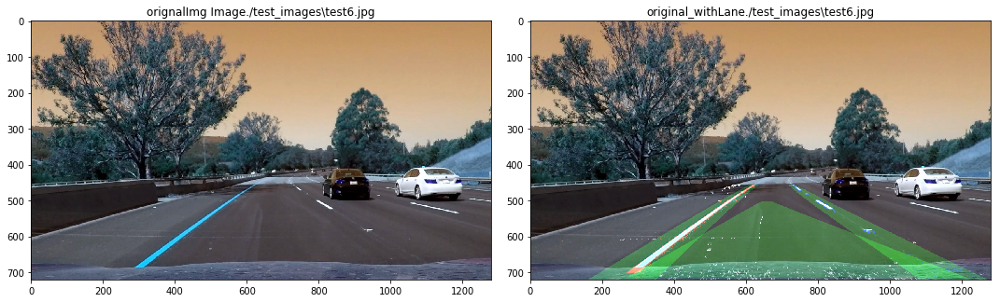

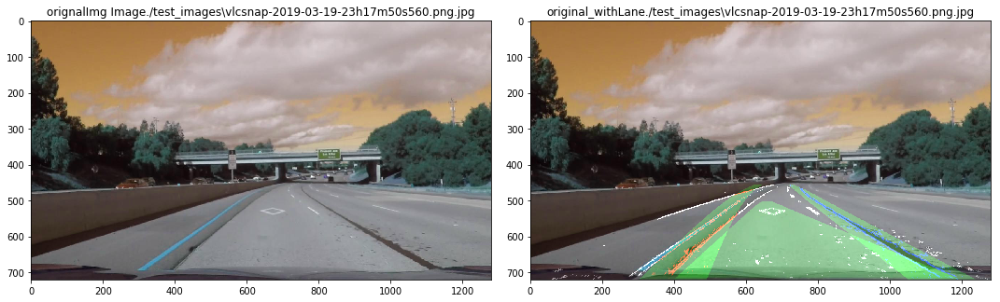

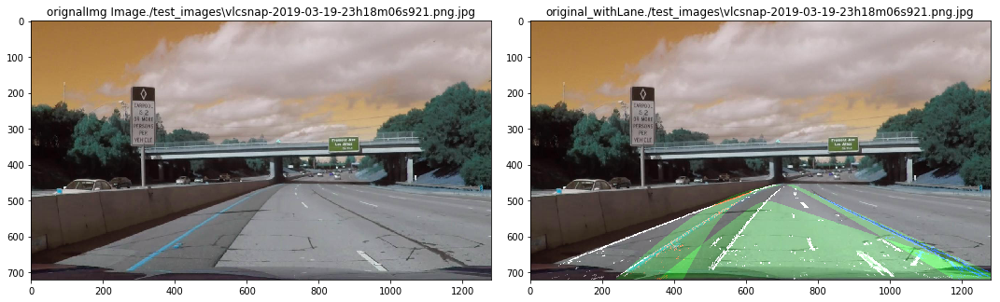

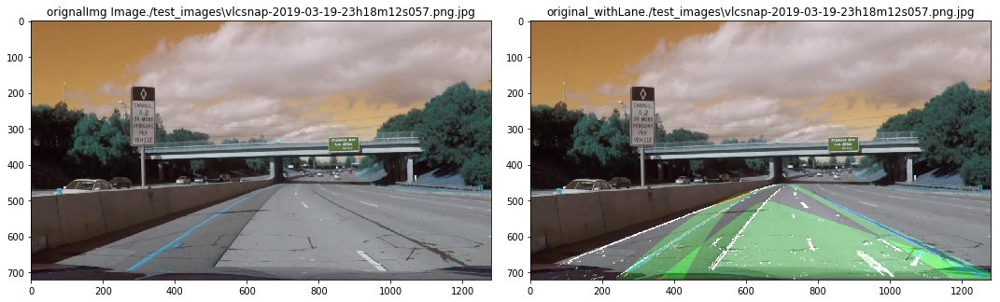

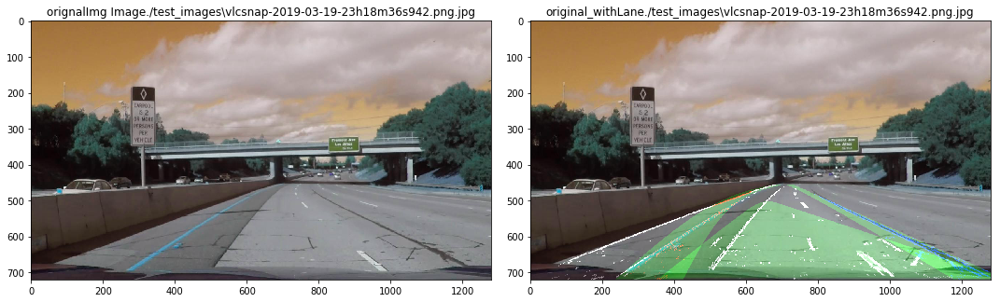

In [117]:

roadImagesNames = glob.glob('./test_images/*.jpg')


# filling in the road....
for fname in roadImagesNames: 
    orignalImg =cv2.imread(fname)
    
    undistortedRoad = cv2.undistort(orignalImg, mtx, dist, None, mtx)
    binaryRoadImage = thresholdHLS(undistortedRoad, s_thresh=(160, 255), sx_thresh=(10, 255))
    
    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst,src)   

    birdseye = cv2.warpPerspective(binaryRoadImage, M, (nx,ny))
    # perform this only to get the left_fit and right_fit coefficients
    
    out_img, left_fitx, right_fitx, left_fit, right_fit, ploty = fit_polynomial(birdseye)    
    result, ploty, right_fitx, left_fitx= search_around_poly(birdseye)   
    
    birds_eye_lane = fillRoadLane(result, left_fit, right_fit)
    #unwarp now to the orginalimage
    unwarp_imageSpace = cv2.warpPerspective(birds_eye_lane, Minv, (undistortedRoad.shape[1], undistortedRoad.shape[0]))
    original_withLane = cv2.addWeighted(orignalImg, 1, unwarp_imageSpace, 0.7, 0)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
    f.tight_layout()
    ax1.imshow(orignalImg, cmap='gray')
    ax1.set_title('orignalImg Image' + fname, fontsize=12)
    
    ax2.imshow(original_withLane, cmap='gray')
    ax2.set_title('original_withLane' + fname, fontsize=12)



In [116]:
##
#
#TO REFACTOR  -> NEED TO IMPLEMENT
#
#
#
#
#
#
#
from moviepy.editor import VideoFileClip

class Lane():
    def __init__(self):
        self.left_fit = None
        self.right_fit = None
        self.left_fit_m = None
        self.right_fit_m = None
        self.leftCurvature = None
        self.rightCurvature = None

def calculateLanes(img):
    """
    Calculates the lane on image `img`.
    """
#     left_fit, right_fit, left_fit_m, right_fit_m, _, _, _, _, _ = findLines(img)
#     # Calculate curvature
#     leftCurvature = calculateCurvature(yRange, left_fit_m) 
#     rightCurvature = calculateCurvature(yRange, right_fit_m)
    
#     # Calculate vehicle center
#     xMax = img.shape[1]*xm_per_pix
#     yMax = img.shape[0]*ym_per_pix
#     vehicleCenter = xMax / 2
#     lineLeft = left_fit_m[0]*yMax**2 + left_fit_m[1]*yMax + left_fit_m[2]
#     lineRight = right_fit_m[0]*yMax**2 + right_fit_m[1]*yMax + right_fit_m[2]
#     lineMiddle = lineLeft + (lineRight - lineLeft)/2
#     diffFromVehicle = lineMiddle - vehicleCenter
    

    
    ######  GIVES LANES ON ROAD WITH FILL
    
    orignalImg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    undistortedRoad = cv2.undistort(orignalImg, mtx, dist, None, mtx)
    binaryRoadImage = thresholdHLS(undistortedRoad, s_thresh=(160, 255), sx_thresh=(10, 255))
    
    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst,src)   

    birdseye = cv2.warpPerspective(binaryRoadImage, M, (nx,ny))
    # perform this only to get the left_fit and right_fit coefficients
    
    out_img, left_fitx, right_fitx, left_fit, right_fit, ploty = fit_polynomial(birdseye)
    
    left_curverad, right_curverad = measure_curvature_real( left_fit, right_fit)
    result, ploty, right_fitx, left_fitx= search_around_poly(birdseye)   
    
    birds_eye_lane = fillRoadLane(result, left_fit, right_fit)
    #unwarp now to the orginalimage
    unwarp_imageSpace = cv2.warpPerspective(birds_eye_lane, Minv, (orignalImg.shape[1], orignalImg.shape[0]))
    original_withLane = cv2.addWeighted(orignalImg, 1, unwarp_imageSpace, 0.7, 0)
    ######
    return (left_fit, right_fit, left_fit, right_fit, left_curverad, right_curverad, 0)

def displayLanes(img, left_fit, right_fit, left_fit_m, right_fit_m, leftCurvature, rightCurvature, diffFromVehicle):
    """
    Display the lanes information on the image.
    """
    output = fillRoadLane(img, left_fit, right_fit)
    
    if diffFromVehicle > 0:
        message = '{:.2f} m right'.format(diffFromVehicle)
    else:
        message = '{:.2f} m left'.format(-diffFromVehicle)
    
    # Draw info
    font = cv2.FONT_HERSHEY_SIMPLEX
    fontColor = (255, 255, 255)
    cv2.putText(output, 'Left curvature: {:.0f} m'.format(leftCurvature), (50, 50), font, 1, fontColor, 2)
    cv2.putText(output, 'Right curvature: {:.0f} m'.format(rightCurvature), (50, 120), font, 1, fontColor, 2)
    cv2.putText(output, 'Vehicle is {} of center'.format(message), (50, 190), font, 1, fontColor, 2)
    return output
    
def videoPipeline(inputVideo, outputVideo):
    """
    Process the `inputVideo` frame by frame to find the lane lines, draw curvarute and vehicle position information and
    generate `outputVideo`
    """
    myclip = VideoFileClip(inputVideo)
    
    leftLane = Lane()
    rightLane = Lane()
    
    def processImage(img):        
        
        left_fit, right_fit, left_fit_m, right_fit_m, leftCurvature, rightCurvature, diffFromVehicle = calculateLanes(img)
               
        if leftCurvature > 10000:
            left_fit = leftLane.left_fit
            left_fit_m = leftLane.left_fit_m
            leftCurvature = leftLane.leftCurvature
        else:
            leftLane.left_fit = left_fit
            leftLane.left_fit_m = left_fit_m
            leftLane.leftCurvature = leftCurvature
        
        if rightCurvature > 10000:
            right_fit = rightLane.right_fit
            right_fit_m = rightLane.right_fit_m
            rightCurvature = rightLane.rightCurvature
        else:
            rightLane.right_fit = right_fit
            rightLane.right_fit_m = right_fit_m
            rightLane.rightCurvature = rightCurvature
            
        return displayLanes(img, left_fit, right_fit, left_fit_m, right_fit_m, leftCurvature, rightCurvature, diffFromVehicle)

    clip = myclip.fl_image(processImage)
    clip.write_videofile(outputVideo, audio=False)
    clip.close()

    
# Project video
#'./test_videos/*.mp4
#print(os.getcwd())
videoPipeline('test_video/harder_challenge_video.mp4', 'video_output/harder_challenge_video.mp4')



[MoviePy] >>>> Building video video_output/harder_challenge_video.mp4
[MoviePy] Writing video video_output/harder_challenge_video.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1199/1200 [02:36<00:00,  8.36it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: video_output/harder_challenge_video.mp4 



In [46]:
resultDisplay = applyAndShow(testImages, lambda img: cv2.cvtColor(pipeline(img), cv2.COLOR_BGR2RGB ))


NameError: name 'applyAndShow' is not defined

In [ ]:
from PIL import Image

challengeImages = glob.glob('./stills/*.png')

for fname in challengeImages:
    im = Image.open(fname)
    rgb_im = im.convert('RGB')
    rgb_im.save(fname +'.jpg')